In [6]:
# import all dependencies
import os
import glob
from pathlib import Path
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import cv2


In [ ]:
def checkFiles(Filepath):
    # Check if the directory exists
    if not Filepath.exists():
        print(f"Directory {Filepath} does not exist!")
    else:
        # List all files in the directory
        list_Filepaths = list(Filepath.glob('*'))
        
        # Count files by extension
        extensions = {}
        for file in list_Filepaths:
            if file.is_file():
                ext = file.suffix.lower()
                if ext not in extensions:
                    extensions[ext] = 0
                extensions[ext] += 1
        
        # Print summary
        print(f"Found {len(list_Filepaths)} files in {Filepath}")
        print("\nFiles by extension:")
        for ext, count in extensions.items():
            print(f"{ext}: {count} files")
    
    return list_Filepaths

def display_image(image_path):
    """Display a single image"""
    # Read image
    img = cv2.imread(str(image_path))
    print(img.shape)
    # Convert from BGR to RGB (matplotlib uses RGB)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    
    # Display
    plt.figure(figsize=(10, 8))
    plt.imshow(img)
    plt.title(f'Image: {image_path.name}')
    plt.axis('off')
    plt.show()

def transform_bounding_boxes(boxes, original_size, new_size, scale, offsets):
    """
    Transform YOLO format bounding boxes when resizing with letterboxing
    
    Parameters:
    -----------
    boxes : list
        List of YOLO format bounding boxes [class_id, x_center, y_center, width, height]
    original_size : tuple
        Original image size (width, height)
    new_size : int
        New square image size (both width and height)
    scale : float
        Scale factor used for resizing
    offsets : tuple
        (x_offset, y_offset) used for centering the image on the canvas
    
    Returns:
    --------
    list
        Transformed bounding boxes in YOLO format
    """
    orig_w, orig_h = original_size
    x_offset, y_offset = offsets
    transformed_boxes = []
    
    for box in boxes:
        class_id, x_center, y_center, width, height = box
        
        # Scale coordinates (apply the same scale factor as the image)
        x_center_scaled = x_center * scale
        y_center_scaled = y_center * scale
        width_scaled = width * scale
        height_scaled = height * scale
        
        # Apply offset (accounting for the padding)
        # First convert from normalized to absolute coordinates
        x_center_abs = x_center_scaled * orig_w
        y_center_abs = y_center_scaled * orig_h
        width_abs = width_scaled * orig_w
        height_abs = height_scaled * orig_h
        
        # Add offset
        x_center_final = (x_center_abs + x_offset) / new_size
        y_center_final = (y_center_abs + y_offset) / new_size
        width_final = width_abs / new_size
        height_final = height_abs / new_size
        
        transformed_boxes.append([class_id, x_center_final, y_center_final, width_final, height_final])
    
    return transformed_boxes

def reshapeImageAndBox(list_Filepaths, new_dim=160, output_dir=None, apply_augmentation=False):
    """
    Reshape images to square dimensions with letterboxing and optionally apply augmentations.
    
    Args:
        list_Filepaths: List of image paths
        new_dim: Size of square output (default: 160)
        output_dir: Directory to save processed files (default: None)
        apply_augmentation: Whether to apply augmentations (default: False)
    """
    if output_dir:
        # Create output directories
        images_dir = Path(output_dir) / 'images'
        labels_dir = Path(output_dir) / 'labels'
        os.makedirs(images_dir, exist_ok=True)
        os.makedirs(labels_dir, exist_ok=True)
        print(f"Output directories created at: {images_dir} and {labels_dir}")
    
    augmentations = ['original', 'flip', 'rotate', 'brightness', 'contrast'] if apply_augmentation else ['original']
    
    for file in list_Filepaths:
        # Read image
        img = cv2.imread(str(file))
        if img is None:
            print(f"Warning: Could not read {file}. Skipping.")
            continue
            
        (h, w) = img.shape[:2]
        print(f"Processing {file.name} - Original: {h}x{w}")
        
        # Get corresponding label file
        label_path = str(file).replace('images', 'labels').replace('.jpg', '.txt').replace('.png', '.txt')
        
        # Read YOLO format labels
        boxes = []
        if os.path.exists(label_path):
            with open(label_path, 'r') as f:
                for line in f.readlines():
                    values = line.strip().split()
                    if len(values) == 5:  # class_id, x_center, y_center, width, height
                        boxes.append([int(values[0])] + [float(v) for v in values[1:]])
        
        # Process each augmentation type
        for aug_type in augmentations:
            # Apply augmentation to the original image
            aug_img, aug_boxes = apply_augmentation_to_image(img, boxes, aug_type)
            
            # Create a square black image for letterboxing
            square_img = np.zeros((new_dim, new_dim, 3), dtype=np.uint8)
            
            # Calculate scaling factor to maintain aspect ratio
            aug_h, aug_w = aug_img.shape[:2]
            scale = min(new_dim/aug_w, new_dim/aug_h)
            
            # Calculate new dimensions
            new_w = int(aug_w * scale)
            new_h = int(aug_h * scale)
            
            # Resize image
            resized = cv2.resize(aug_img, (new_w, new_h), interpolation=cv2.INTER_AREA)
            
            # Calculate position to paste (center)
            x_offset = (new_dim - new_w) // 2
            y_offset = (new_dim - new_h) // 2
            
            # Paste resized image onto square canvas
            square_img[y_offset:y_offset+new_h, x_offset:x_offset+new_w] = resized
            
            # Transform bounding boxes to account for letterboxing
            transformed_boxes = transform_bounding_boxes(
                aug_boxes, 
                (aug_w, aug_h), 
                new_dim, 
                scale, 
                (x_offset, y_offset)
            )
            
            # Display images with bounding boxes (only for original to avoid clutter)
            if aug_type == 'original':
                plt.figure(figsize=(10, 5))
                
                # Original image with boxes
                plt.subplot(1, 2, 1)
                plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
                for box in boxes:
                    class_id, x_center, y_center, width, height = box
                    x1 = int((x_center - width/2) * w)
                    y1 = int((y_center - height/2) * h)
                    x2 = int((x_center + width/2) * w)
                    y2 = int((y_center + height/2) * h)
                    plt.gca().add_patch(plt.Rectangle((x1, y1), x2-x1, y2-y1, 
                                                    fill=False, edgecolor='red', linewidth=2))
                plt.title('Original')
                plt.axis('off')
                
                # Processed image with boxes
                plt.subplot(1, 2, 2)
                plt.imshow(cv2.cvtColor(square_img, cv2.COLOR_BGR2RGB))
                for box in transformed_boxes:
                    class_id, x_center, y_center, width, height = box
                    x1 = int((x_center - width/2) * new_dim)
                    y1 = int((y_center - height/2) * new_dim)
                    x2 = int((x_center + width/2) * new_dim)
                    y2 = int((y_center + height/2) * new_dim)
                    plt.gca().add_patch(plt.Rectangle((x1, y1), x2-x1, y2-y1, 
                                                    fill=False, edgecolor='red', linewidth=2))
                plt.title(f'Letterboxed ({new_dim}x{new_dim})')
                plt.axis('off')
                
                plt.tight_layout()
                plt.show()
            
            # Save transformed image and labels
            if output_dir:
                # Create filename with augmentation type
                base_name = file.stem
                if aug_type != 'original':
                    base_name = f"{base_name}_{aug_type}"
                
                img_filename = f"{base_name}{file.suffix}"
                label_filename = f"{base_name}.txt"
                
                output_img_path = images_dir / img_filename
                output_label_path = labels_dir / label_filename
            else:
                # Fallback to replacing 'original' with 'processed'
                output_img_path = str(file).replace('original', f'processed_{aug_type}')
                output_label_path = label_path.replace('original', f'processed_{aug_type}')
            
            # Save the image and labels
            cv2.imwrite(str(output_img_path), square_img)
            with open(str(output_label_path), 'w') as f:
                for box in transformed_boxes:
                    line = ' '.join([str(int(box[0]))] + [f"{v:.6f}" for v in box[1:]])
                    f.write(line + '\n')
                    
            print(f"Saved {aug_type} augmentation to {output_img_path}")

def apply_augmentation_to_image(image, boxes, aug_type):
    """
    Apply various augmentations to an image and adjust bounding boxes accordingly
    
    Args:
        image: Input image
        boxes: Bounding boxes in YOLO format [class, x_center, y_center, width, height]
        aug_type: Type of augmentation ('original', 'flip', 'rotate', 'brightness', 'contrast')
        
    Returns:
        Tuple of (augmented image, augmented boxes)
    """
    h, w = image.shape[:2]
    
    # Return original image if no augmentation or 'original' type
    if aug_type == 'original':
        return image.copy(), boxes.copy()
    
    # Horizontal flip
    if aug_type == 'flip':
        flipped_img = cv2.flip(image, 1)  # 1 means horizontal flip
        flipped_boxes = []
        
        for box in boxes:
            class_id, x_center, y_center, width, height = box
            # Flip horizontal coordinate: new_x = 1 - old_x
            flipped_boxes.append([class_id, 1.0 - x_center, y_center, width, height])
            
        return flipped_img, flipped_boxes
    
    # Random rotation (±15 degrees)
    elif aug_type == 'rotate':
        angle = np.random.uniform(-15, 15)
        center = (w // 2, h // 2)
        rotation_matrix = cv2.getRotationMatrix2D(center, angle, 1.0)
        
        # Get new image dimensions after rotation
        cos = np.abs(rotation_matrix[0, 0])
        sin = np.abs(rotation_matrix[0, 1])
        new_w = int((h * sin) + (w * cos))
        new_h = int((h * cos) + (w * sin))
        
        # Adjust the rotation matrix
        rotation_matrix[0, 2] += (new_w / 2) - center[0]
        rotation_matrix[1, 2] += (new_h / 2) - center[1]
        
        # Perform rotation
        rotated_img = cv2.warpAffine(image, rotation_matrix, (new_w, new_h))
        
        # Transform boxes - this is complex and requires converting to corners then back
        rotated_boxes = []
        for box in boxes:
            class_id, x_center, y_center, width, height = box
            
            # Convert to absolute coordinates for corners
            x1 = int((x_center - width/2) * w)
            y1 = int((y_center - height/2) * h)
            x2 = int((x_center + width/2) * w)
            y2 = int((y_center + height/2) * h)
            
            # Get all four corners
            corners = np.array([
                [x1, y1],
                [x2, y1],
                [x2, y2],
                [x1, y2]
            ], dtype=np.float32)
            
            # Transform corners
            ones = np.ones((4, 1))
            corners_homogeneous = np.hstack([corners, ones])
            transformed_corners = np.dot(corners_homogeneous, rotation_matrix.T)
            
            # Get bounding box of transformed corners
            min_x = np.min(transformed_corners[:, 0])
            min_y = np.min(transformed_corners[:, 1])
            max_x = np.max(transformed_corners[:, 0])
            max_y = np.max(transformed_corners[:, 1])
            
            # Convert back to YOLO format with new image dimensions
            new_x_center = (min_x + max_x) / 2 / new_w
            new_y_center = (min_y + max_y) / 2 / new_h
            new_width = (max_x - min_x) / new_w
            new_height = (max_y - min_y) / new_h
            
            # Clip values to ensure they're within [0,1]
            new_x_center = max(0, min(1, new_x_center))
            new_y_center = max(0, min(1, new_y_center))
            new_width = max(0, min(1, new_width))
            new_height = max(0, min(1, new_height))
            
            rotated_boxes.append([class_id, new_x_center, new_y_center, new_width, new_height])
            
        return rotated_img, rotated_boxes
    
    # Brightness adjustment
    elif aug_type == 'brightness':
        # Convert to HSV
        hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
        
        # Randomly adjust brightness (V)
        factor = np.random.uniform(0.7, 1.3)
        v = hsv[:, :, 2]
        v = np.clip(v * factor, 0, 255).astype(np.uint8)
        hsv[:, :, 2] = v
        
        # Convert back to BGR
        bright_img = cv2.cvtColor(hsv, cv2.COLOR_HSV2BGR)
        
        # Bounding boxes don't change
        return bright_img, boxes.copy()
    
    # Contrast adjustment
    elif aug_type == 'contrast':
        # Apply contrast adjustment
        factor = np.random.uniform(0.7, 1.5)
        
        # Formula: new_img = alpha * img + beta
        contrast_img = cv2.convertScaleAbs(image, alpha=factor, beta=0)
        
        # Bounding boxes don't change
        return contrast_img, boxes.copy()
    
    # Default case
    return image.copy(), boxes.copy()

In [9]:
# Define Paths: 
train_dir = Path('./Eye_dataset_V5/train/images')
test_dir = Path('./Eye_dataset_V5/test/images')
val_dir = Path('./Eye_dataset_V5/valid/images')

In [10]:
train_filepaths = checkFiles(train_dir)
val_filepaths = checkFiles(val_dir)
test_filepaths = checkFiles(test_dir)

Found 350 files in Eye_dataset_V5/train/images

Files by extension:
.jpg: 350 files
Found 100 files in Eye_dataset_V5/valid/images

Files by extension:
.jpg: 100 files
Found 49 files in Eye_dataset_V5/test/images

Files by extension:
.jpg: 49 files


Original: 160x160
Resized: 160x160


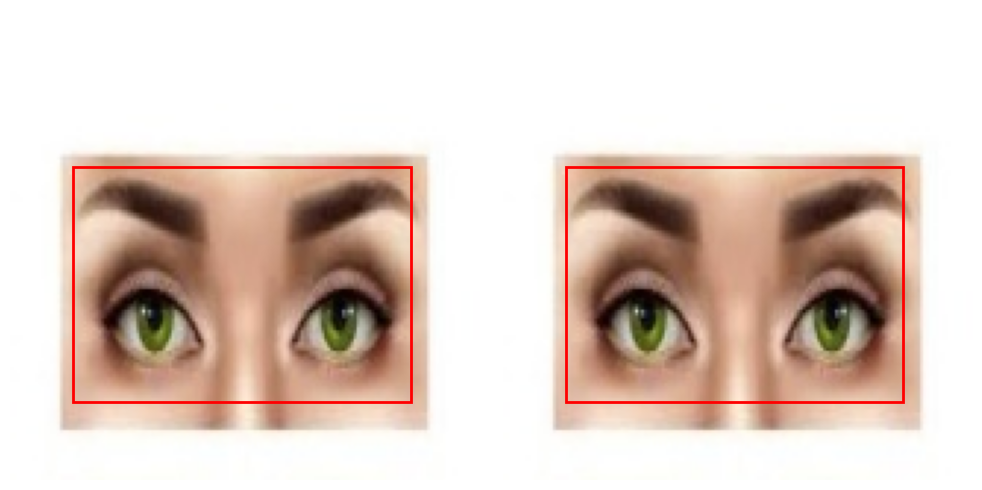

Original: 160x160
Resized: 160x160


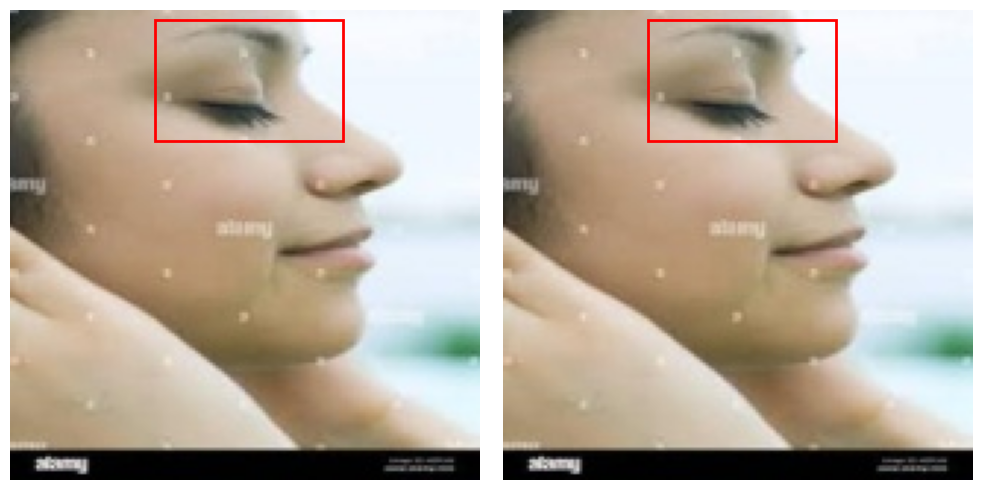

Original: 160x160
Resized: 160x160


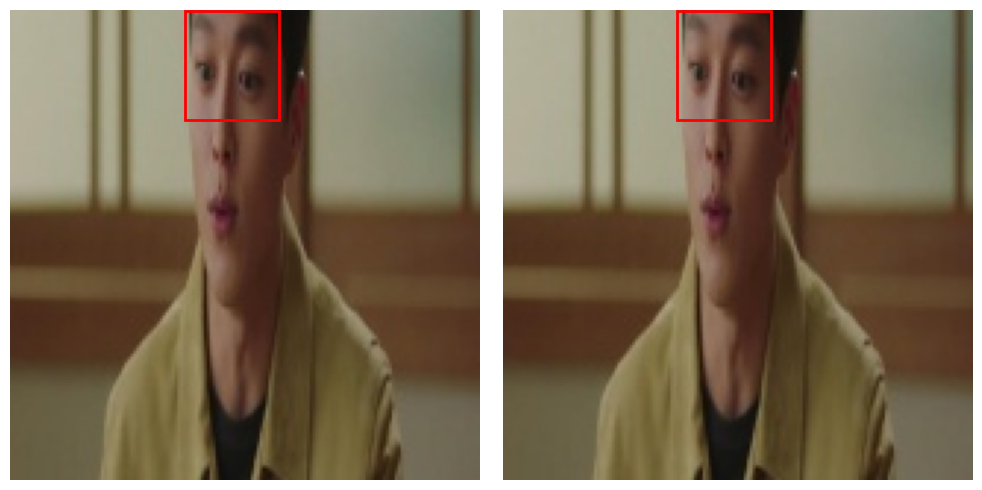

Original: 160x160
Resized: 160x160


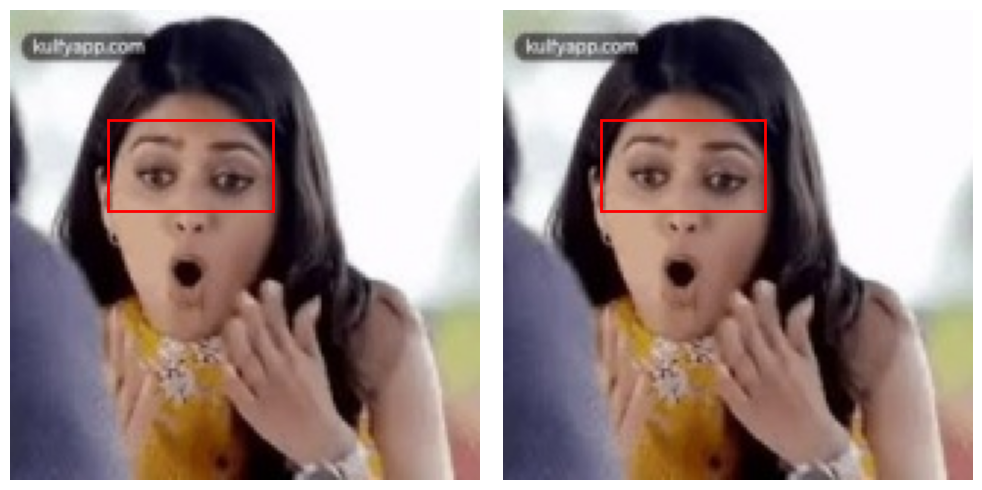

Original: 160x160
Resized: 160x160


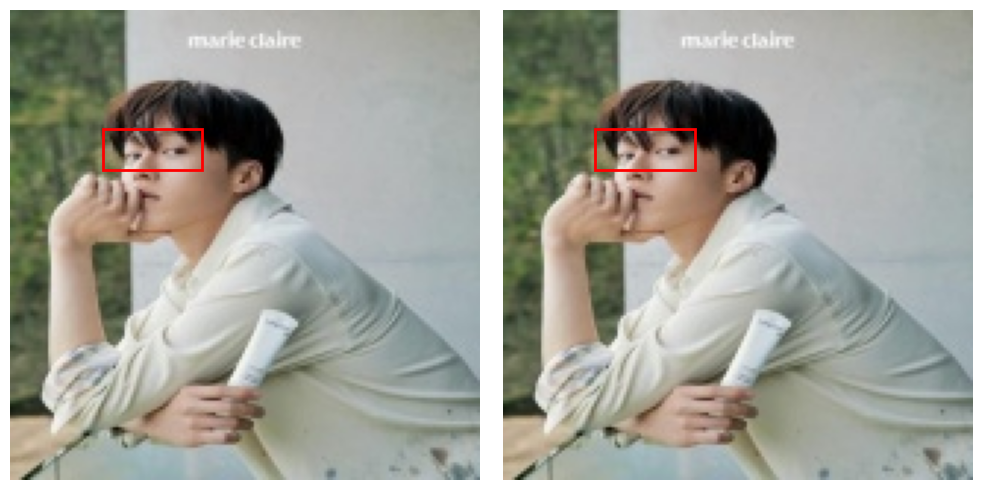

Original: 160x160
Resized: 160x160


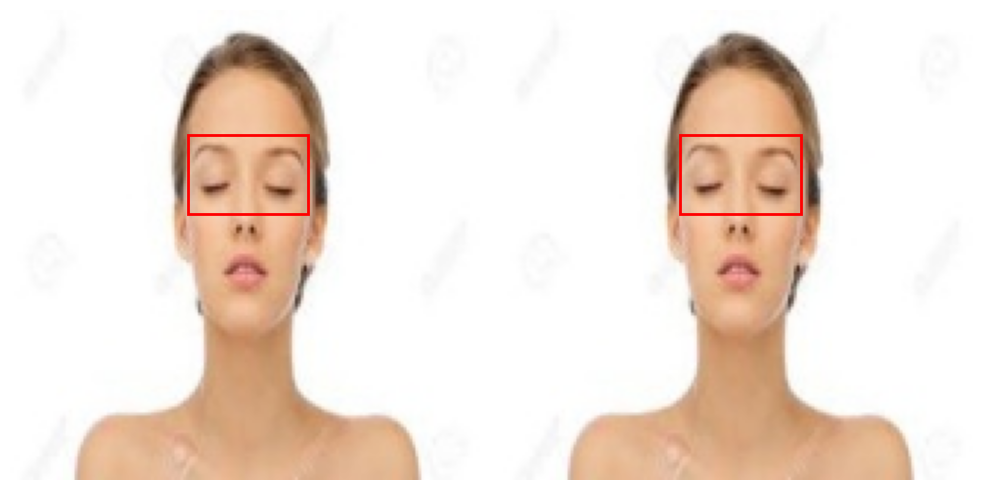

Original: 160x160
Resized: 160x160


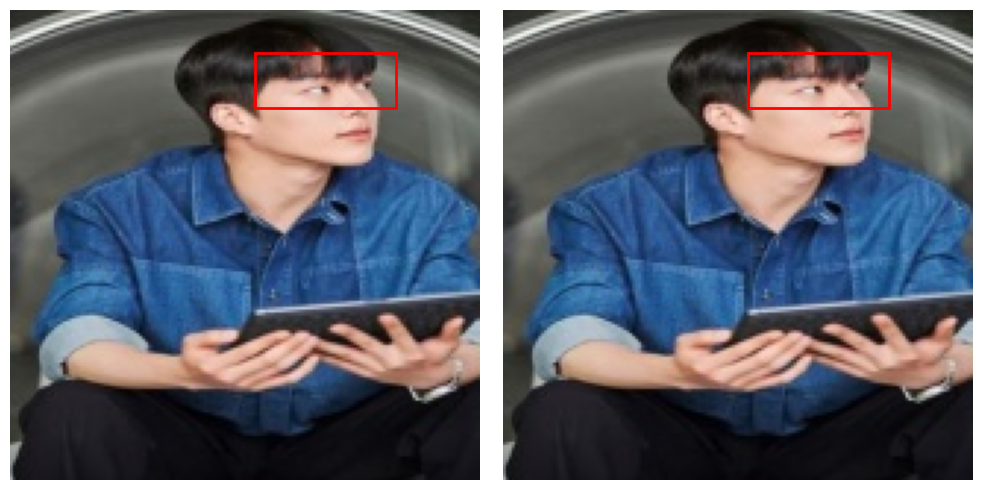

Original: 160x160
Resized: 160x160


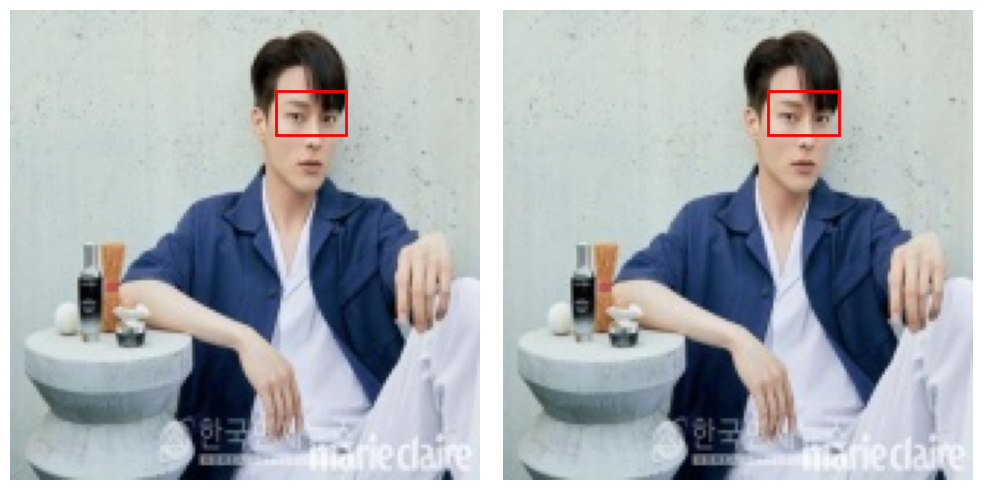

Original: 160x160
Resized: 160x160


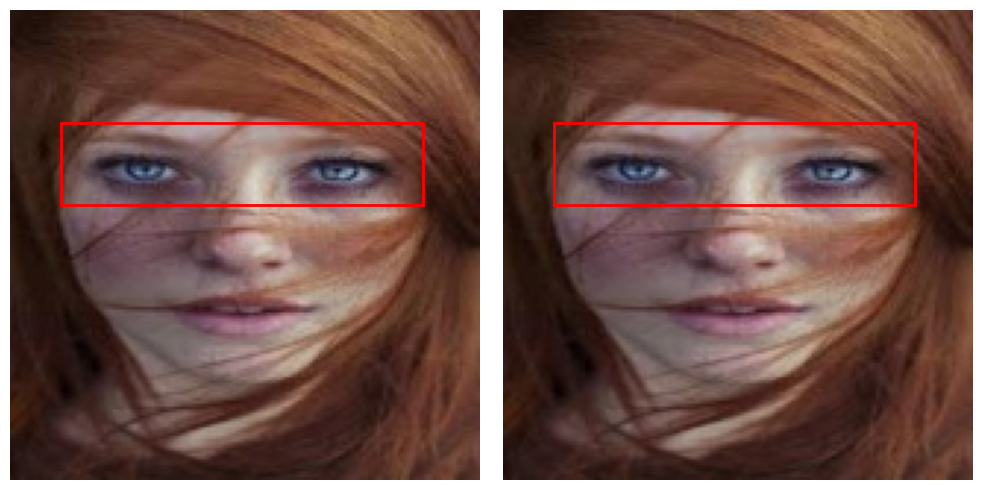

Original: 160x160
Resized: 160x160


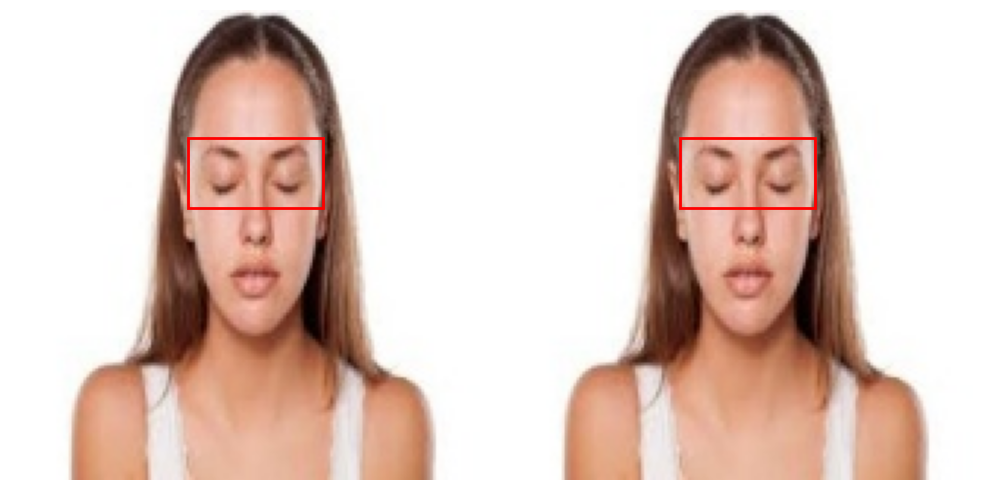

Original: 160x160
Resized: 160x160


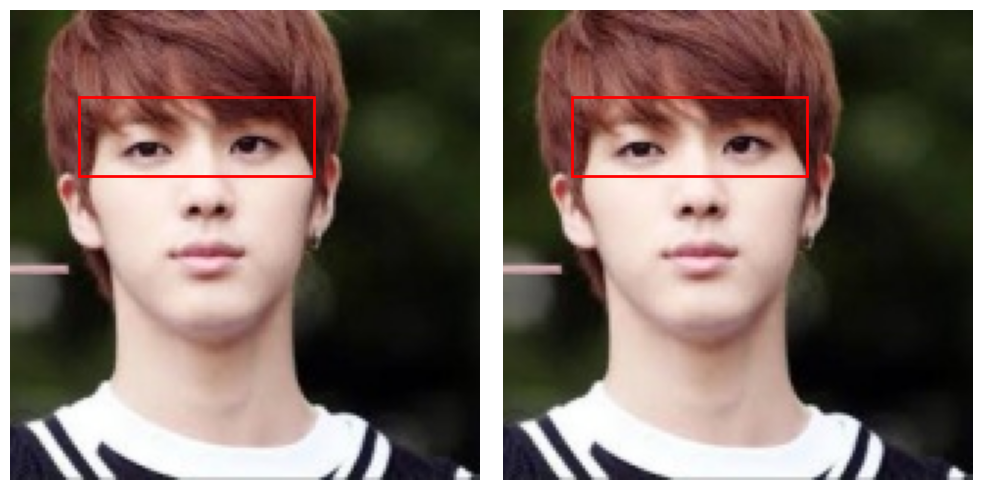

Original: 160x160
Resized: 160x160


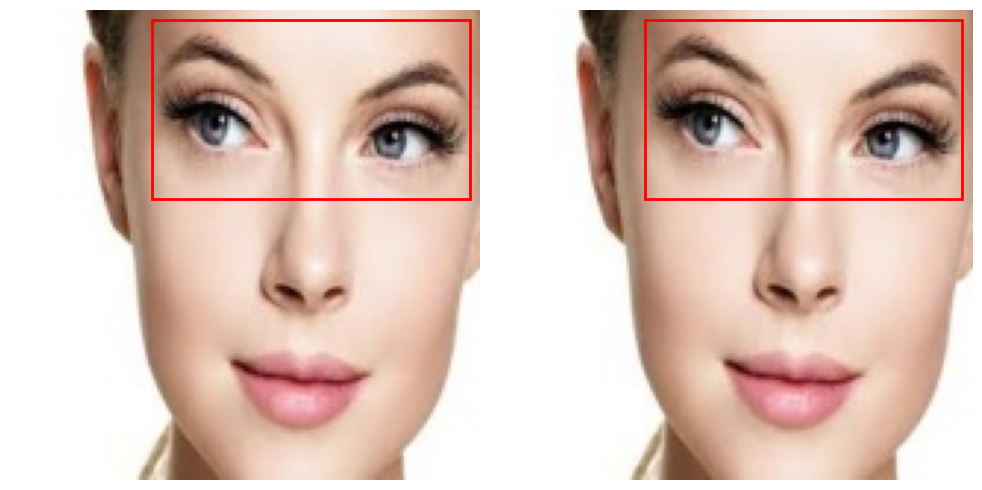

Original: 160x160
Resized: 160x160


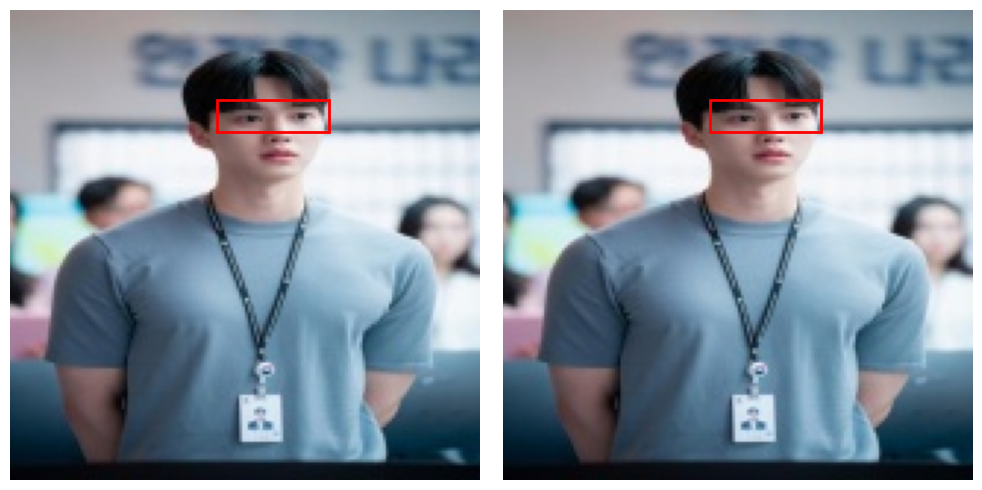

Original: 416x416
Resized: 160x160


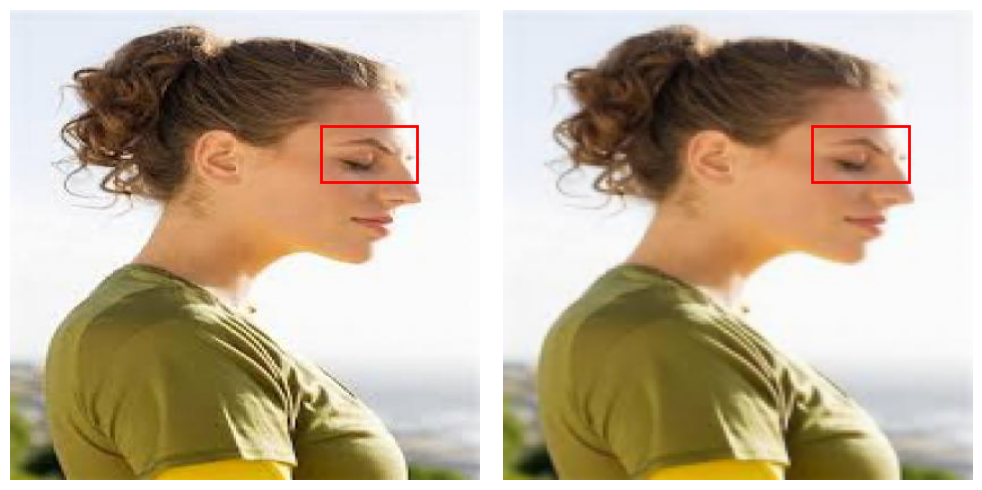

Original: 416x416
Resized: 160x160


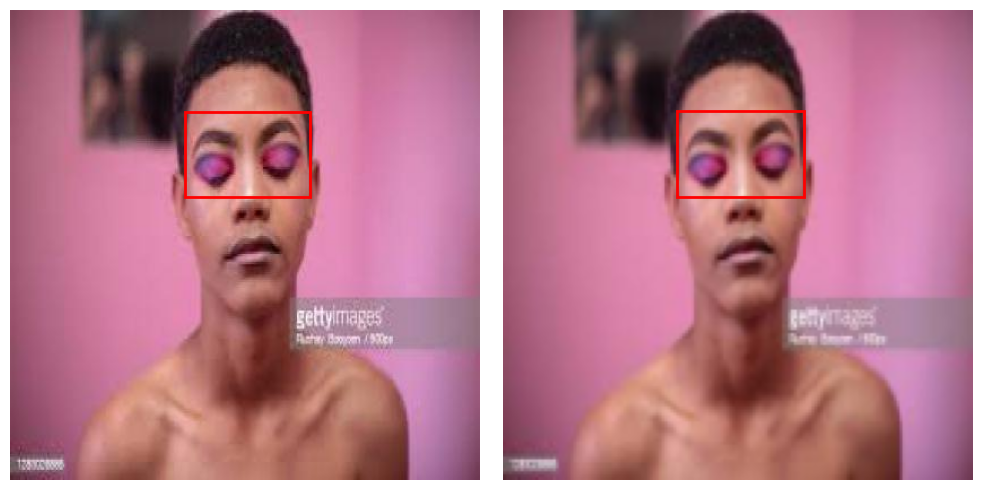

Original: 416x416
Resized: 160x160


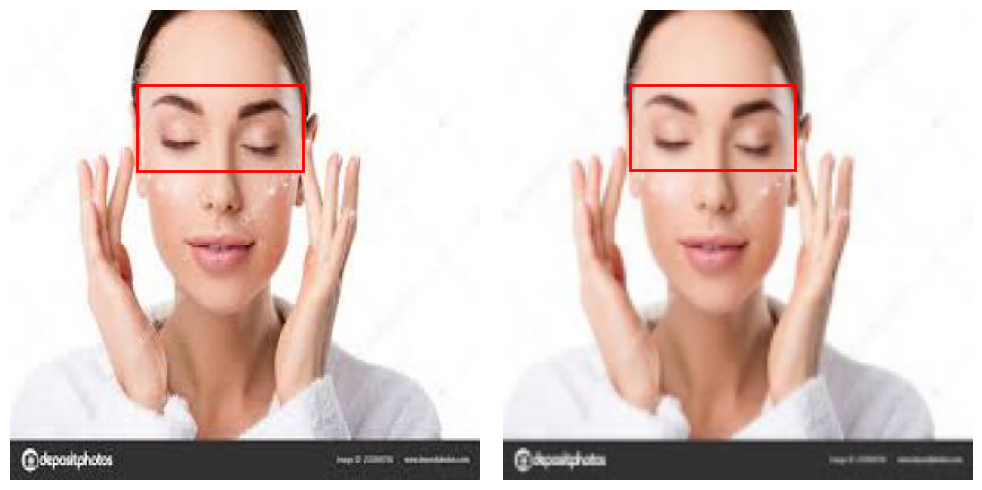

Original: 416x416
Resized: 160x160


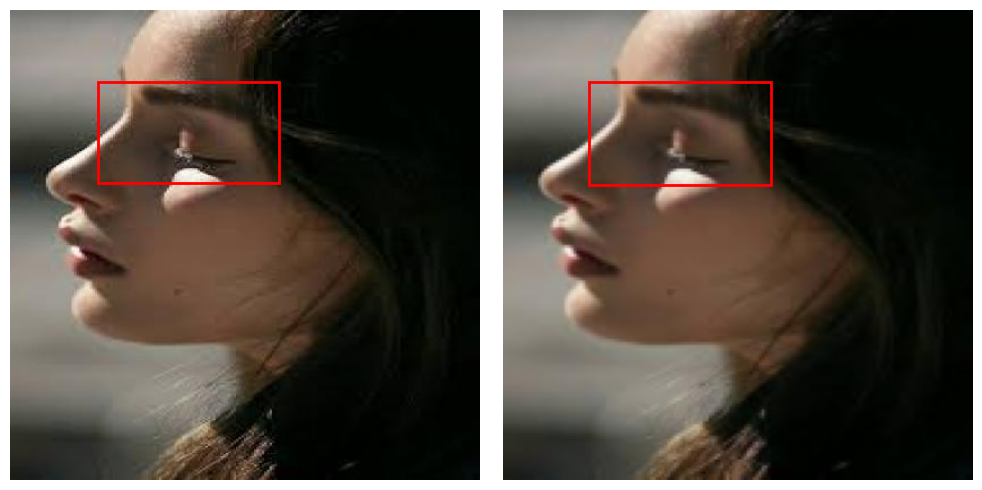

Original: 416x416
Resized: 160x160


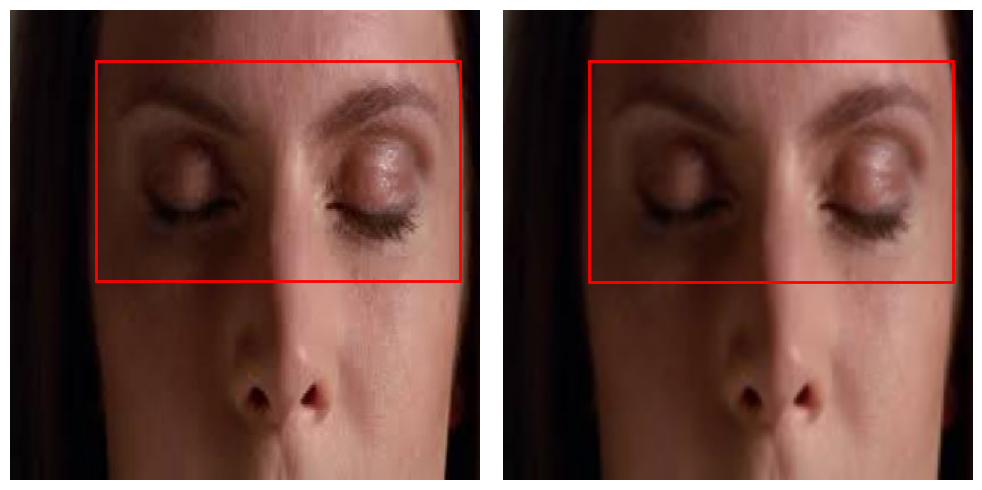

Original: 416x416
Resized: 160x160


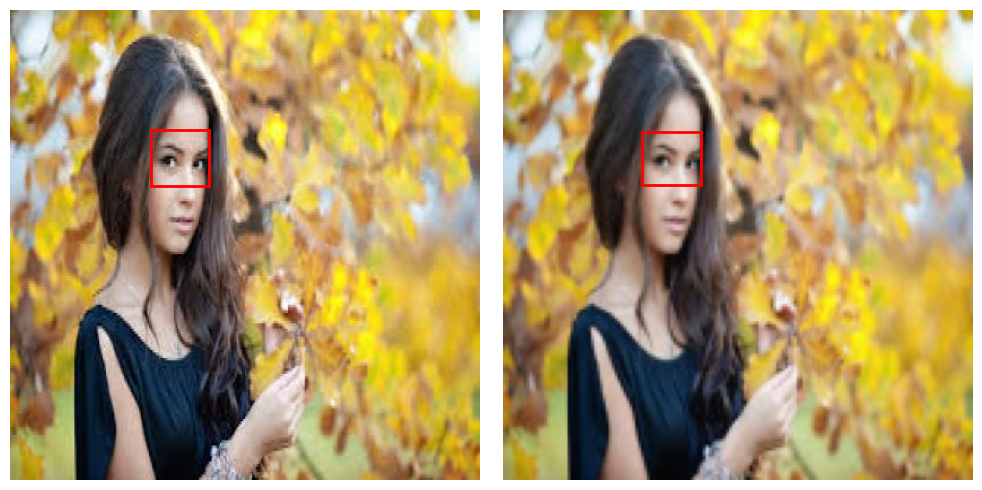

Original: 416x416
Resized: 160x160


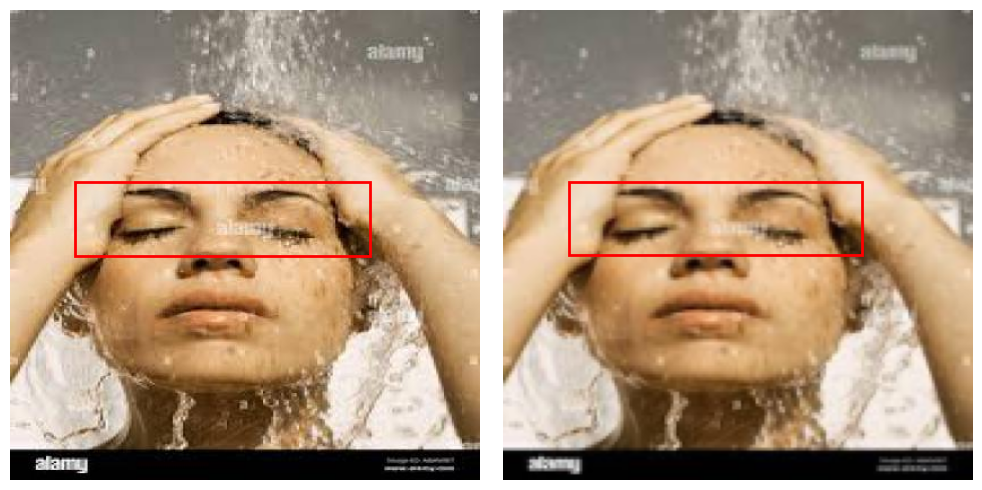

Original: 416x416
Resized: 160x160


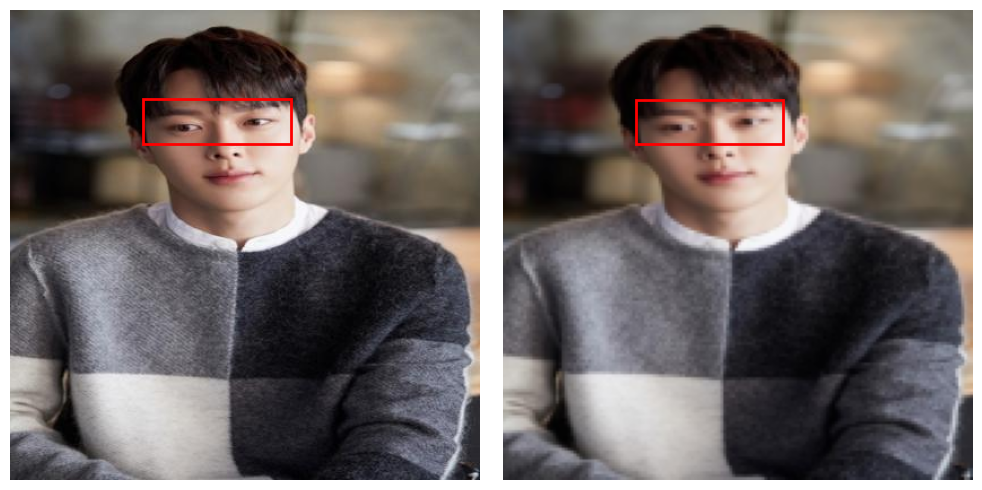

Original: 416x416
Resized: 160x160


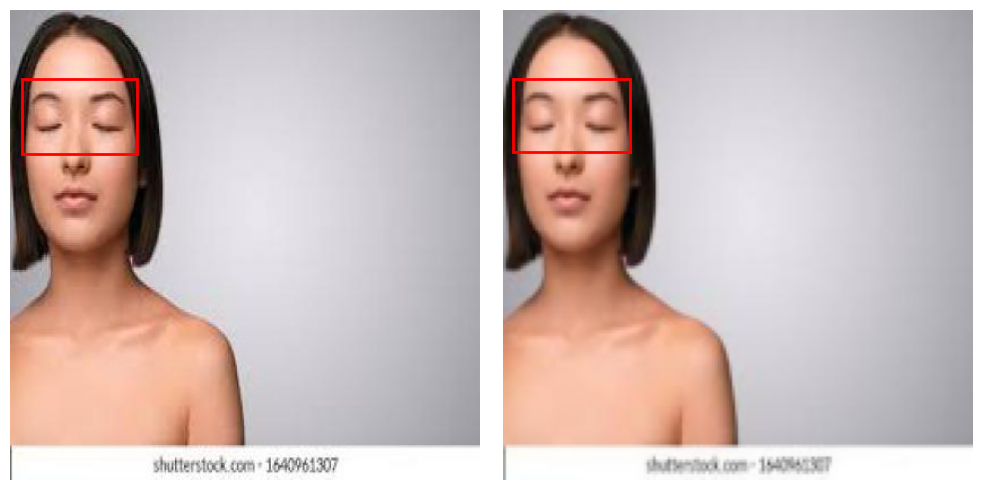

Exception ignored in: <bound method IPythonKernel._clean_thread_parent_frames of <ipykernel.ipkernel.IPythonKernel object at 0x1044eeed0>>
Traceback (most recent call last):
  File "/Users/seunghyunlee/.pyenv/versions/3.12.4/lib/python3.12/site-packages/ipykernel/ipkernel.py", line 775, in _clean_thread_parent_frames
    def _clean_thread_parent_frames(

KeyboardInterrupt: 


Original: 416x416
Resized: 160x160


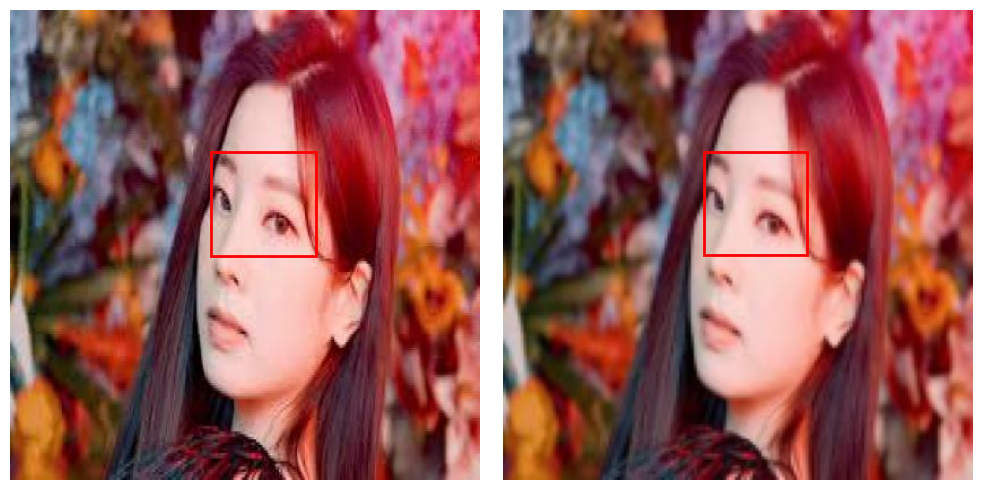

Original: 416x416
Resized: 160x160


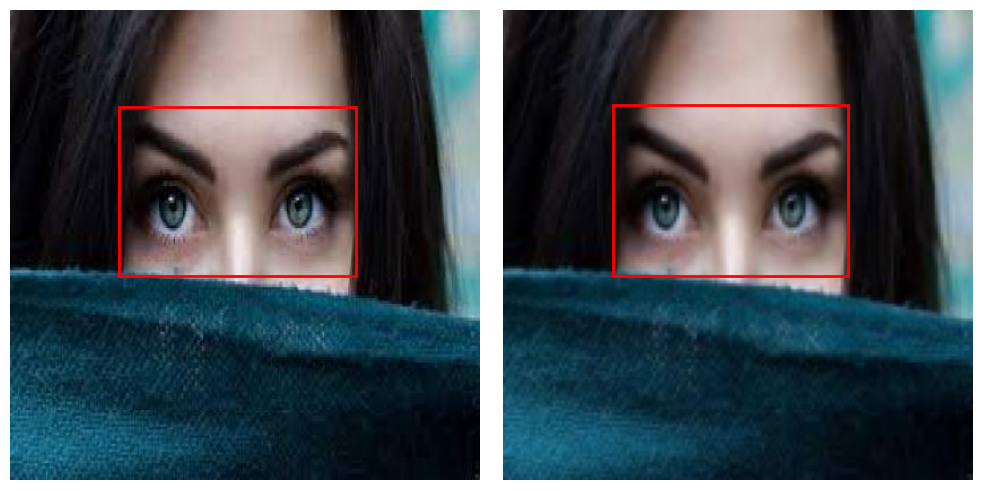

Original: 416x416
Resized: 160x160


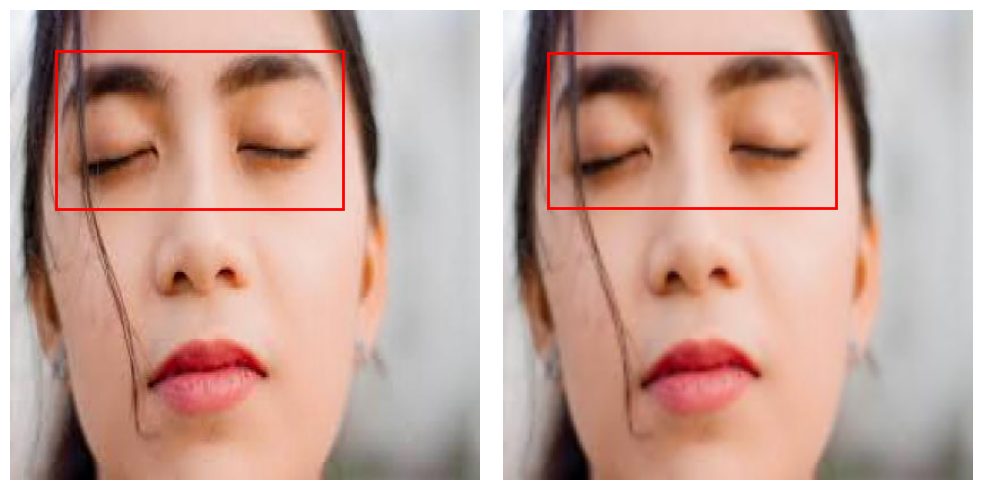

Original: 416x416
Resized: 160x160


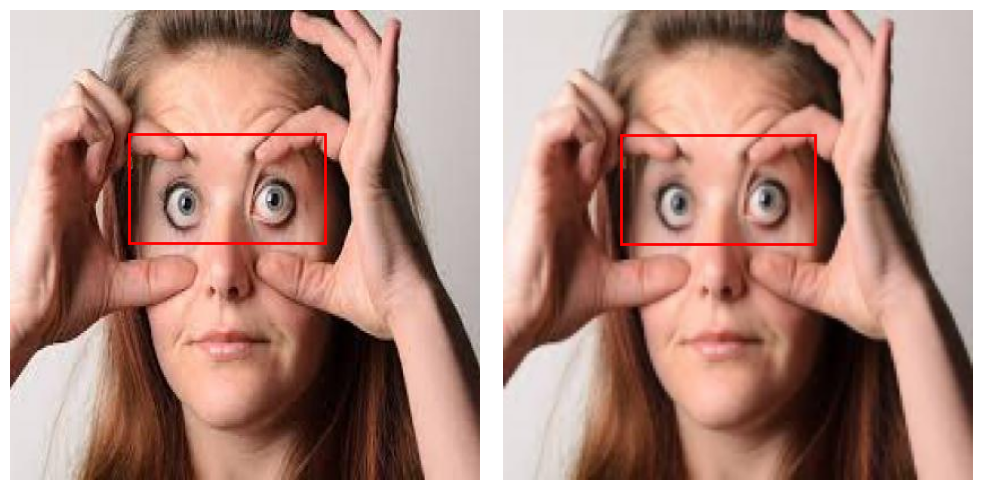

Original: 416x416
Resized: 160x160


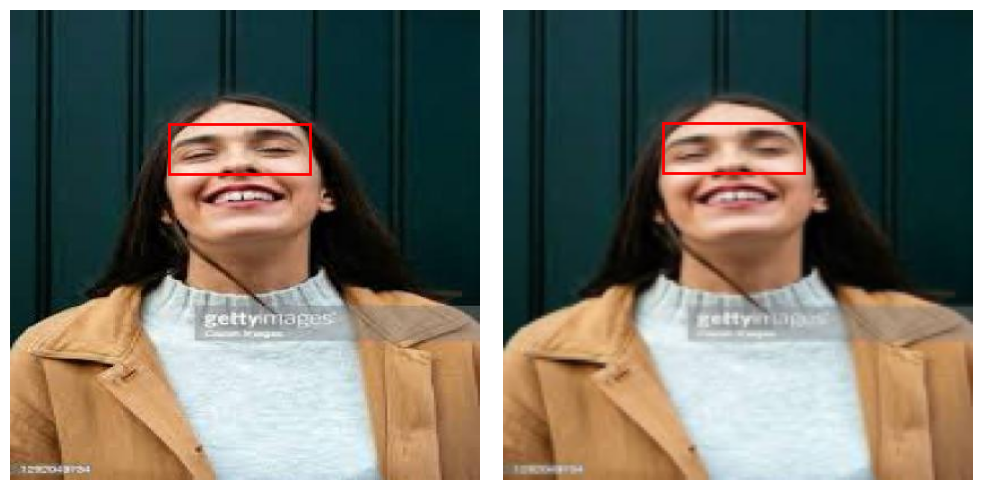

Original: 416x416
Resized: 160x160


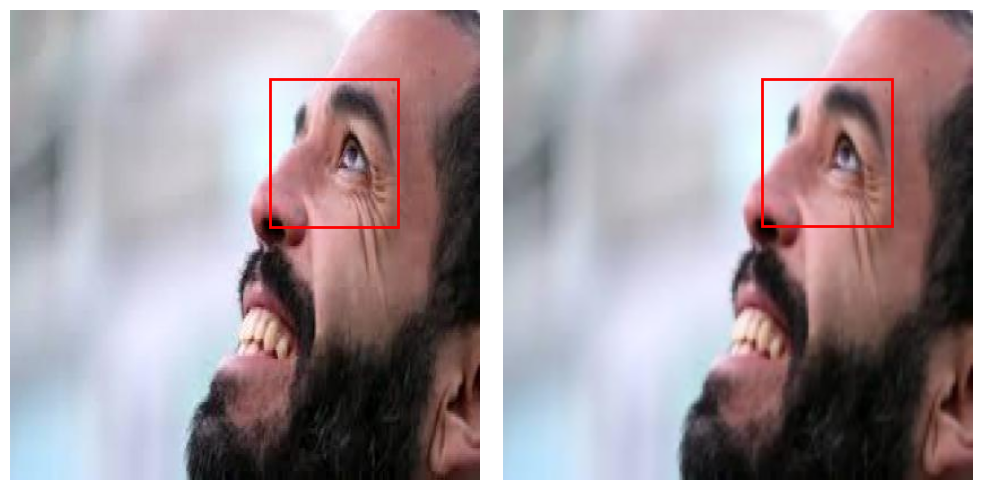

Original: 416x416
Resized: 160x160


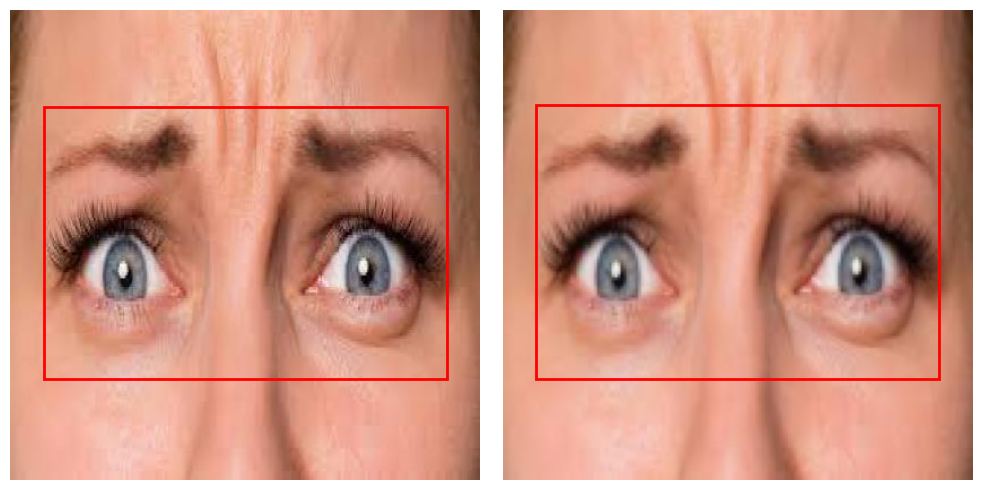

Original: 416x416
Resized: 160x160


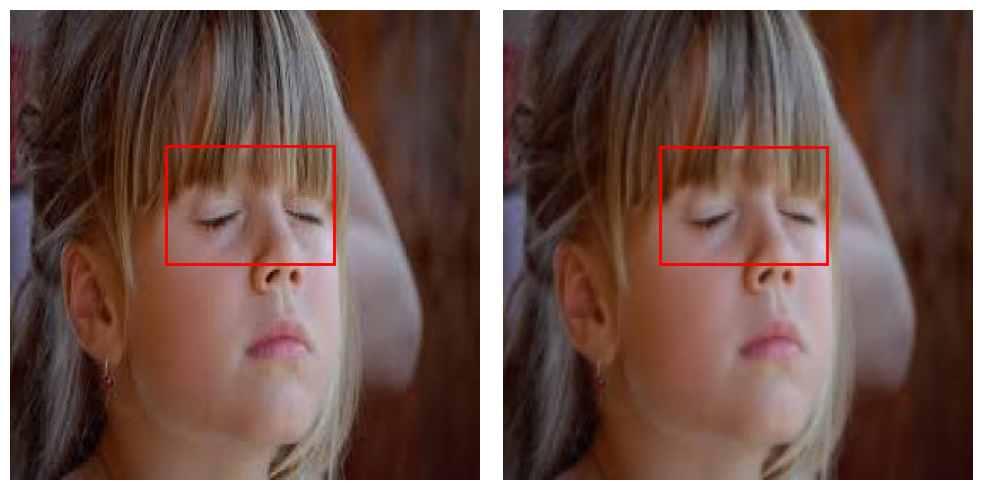

Original: 416x416
Resized: 160x160


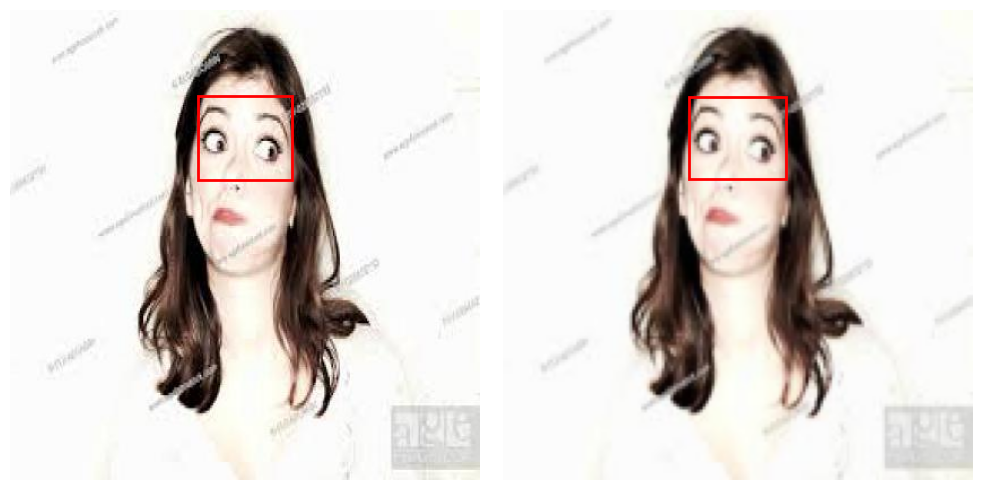

Original: 416x416
Resized: 160x160


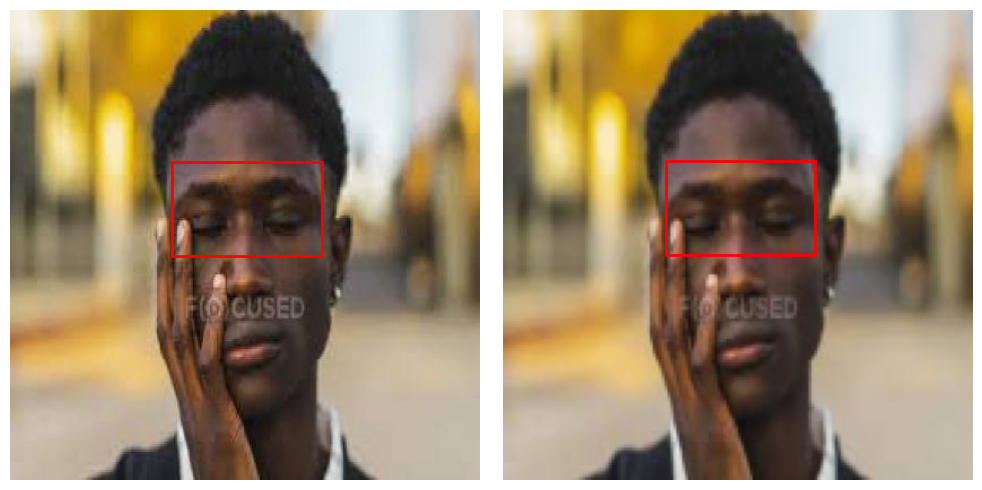

Original: 416x416
Resized: 160x160


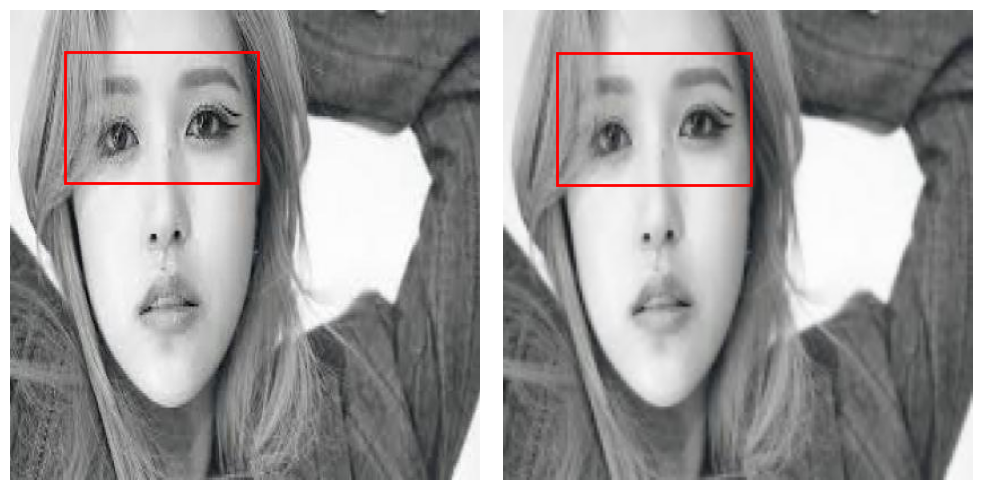

Original: 416x416
Resized: 160x160


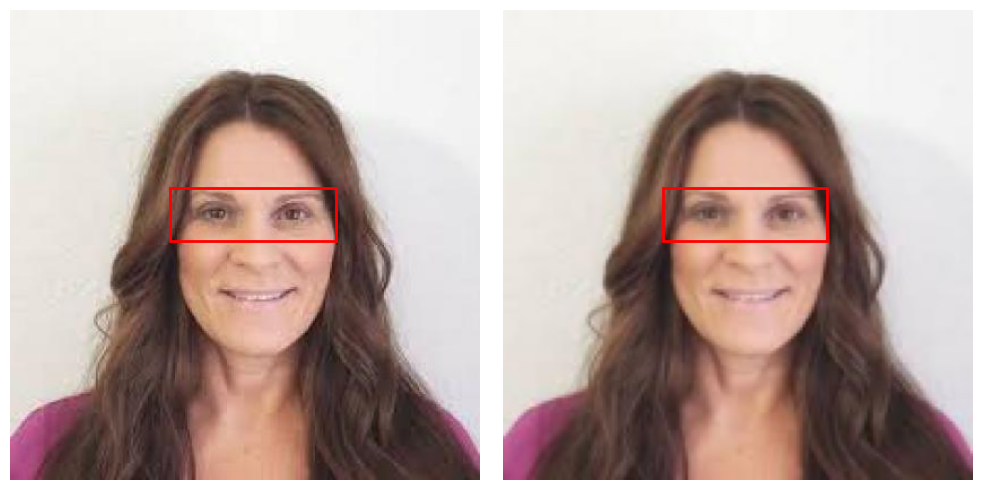

Original: 416x416
Resized: 160x160


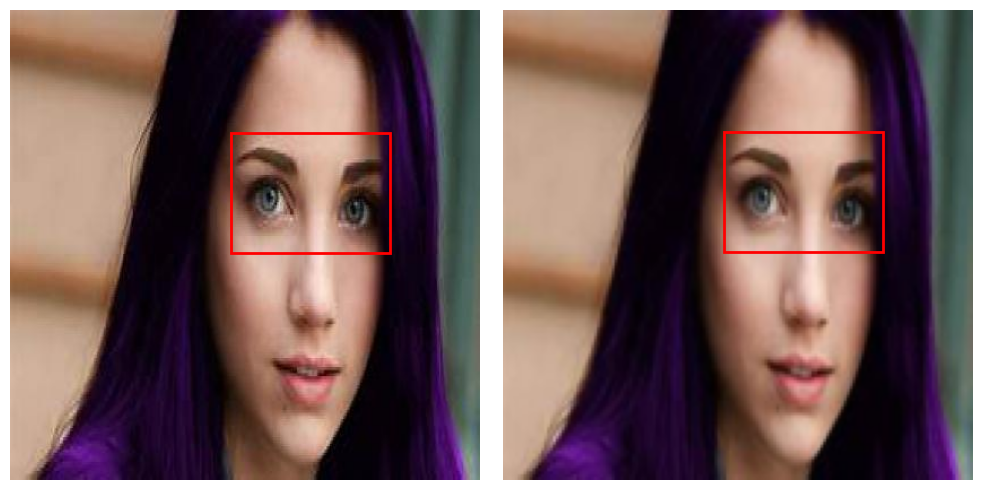

Original: 416x416
Resized: 160x160


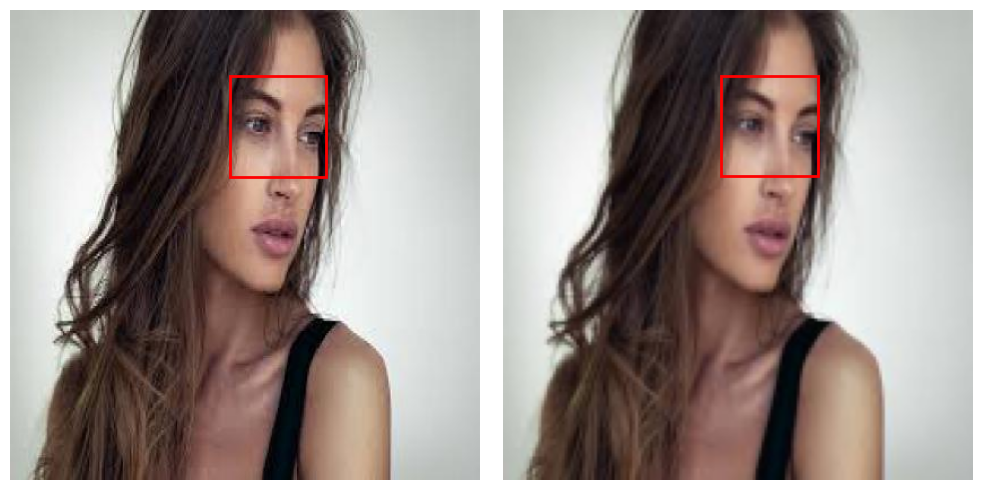

Original: 416x416
Resized: 160x160


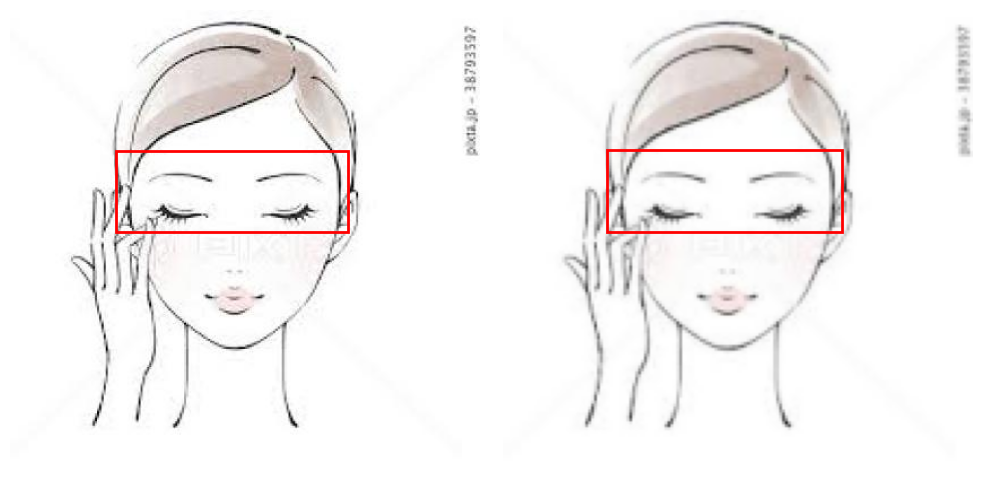

Original: 416x416
Resized: 160x160


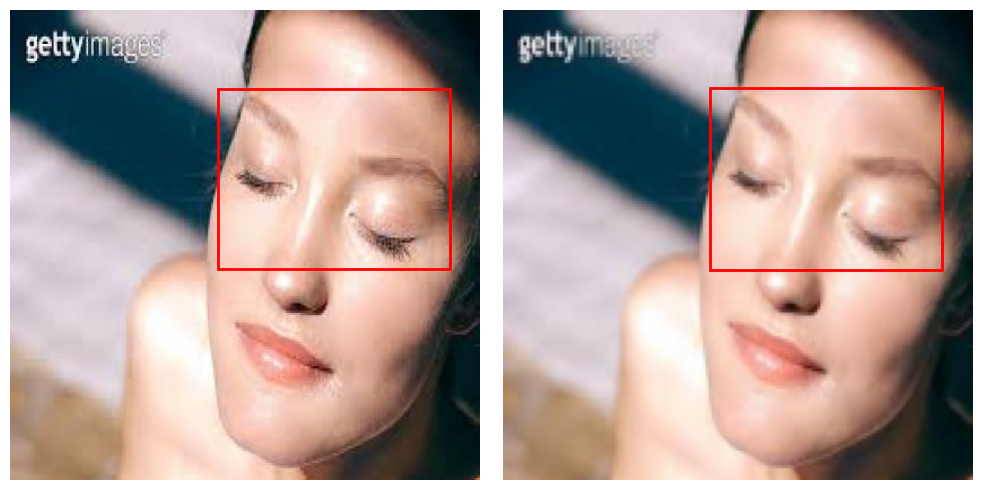

Original: 416x416
Resized: 160x160


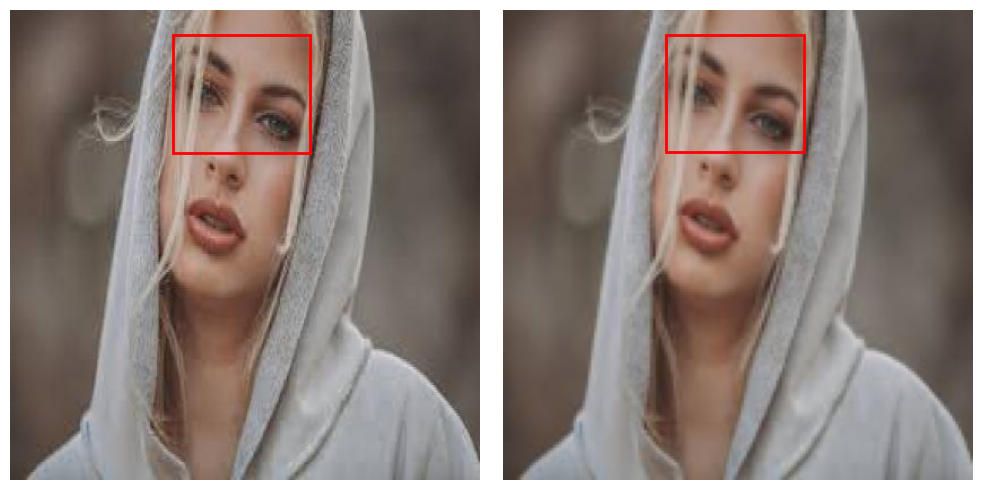

Original: 416x416
Resized: 160x160


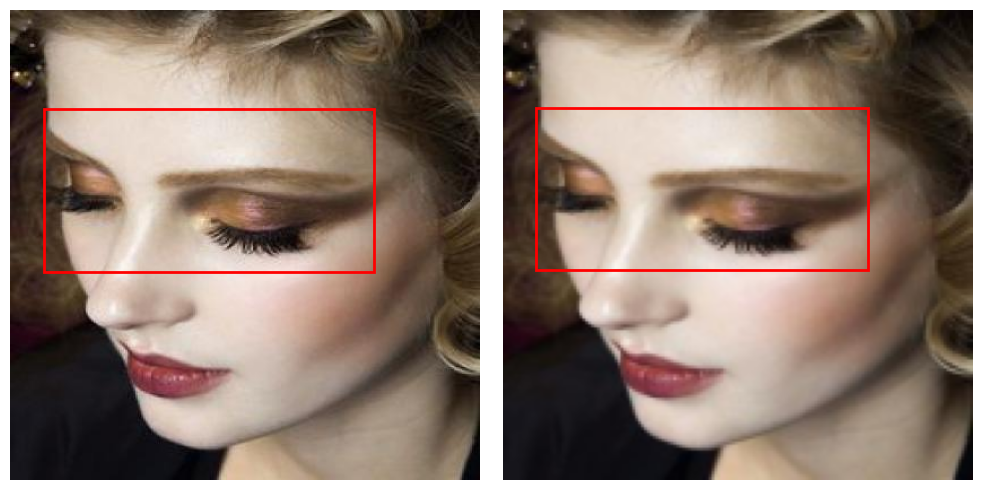

Original: 416x416
Resized: 160x160


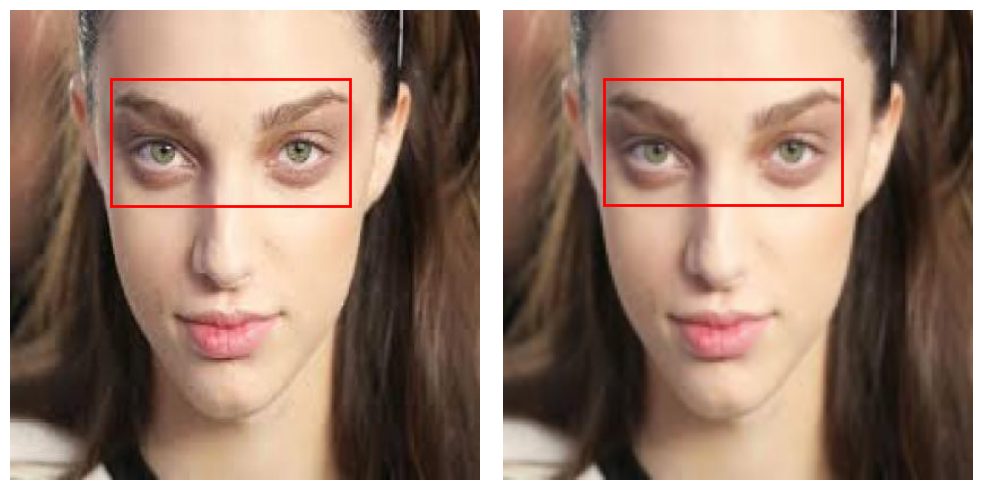

Original: 416x416
Resized: 160x160


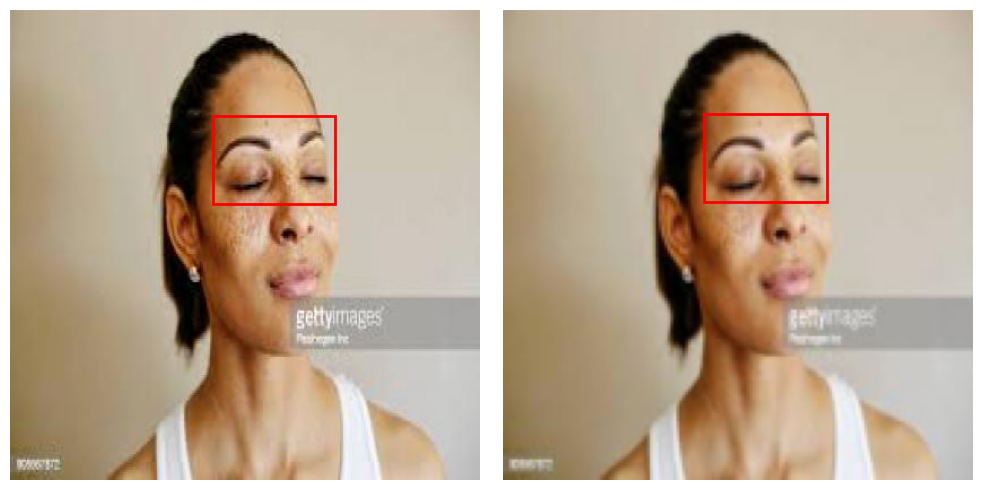

Original: 416x416
Resized: 160x160


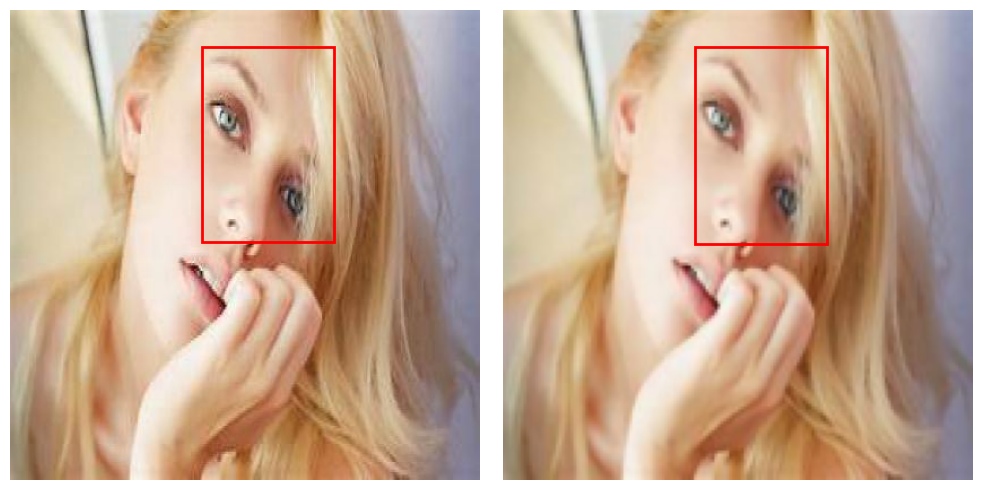

Original: 416x416
Resized: 160x160


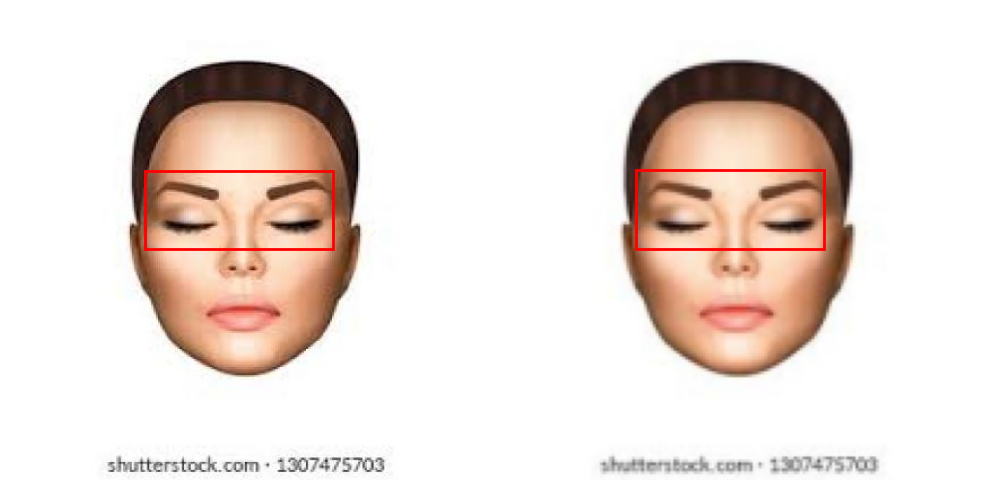

Original: 416x416
Resized: 160x160


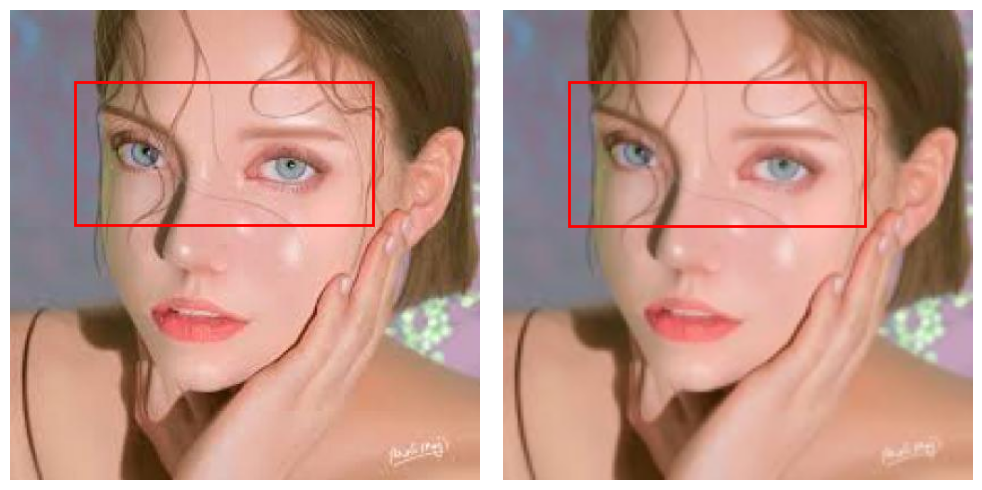

Original: 416x416
Resized: 160x160


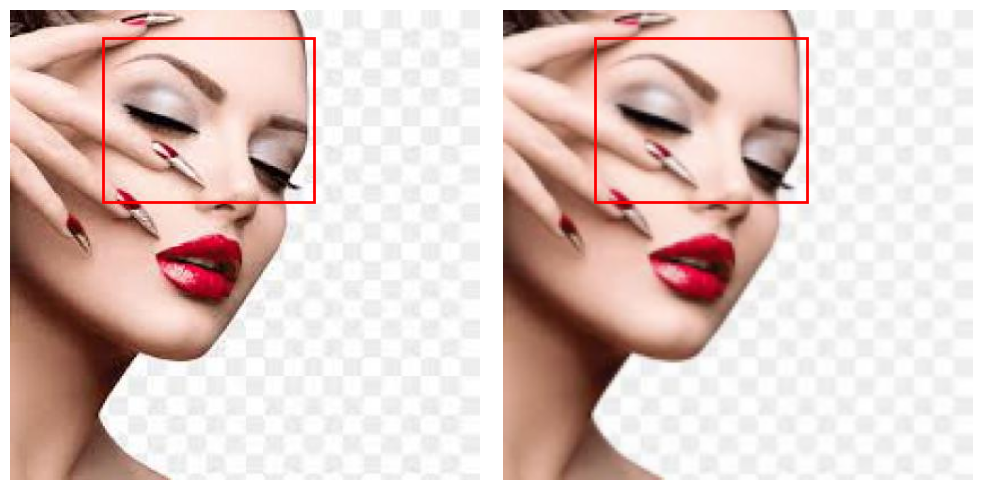

Original: 416x416
Resized: 160x160


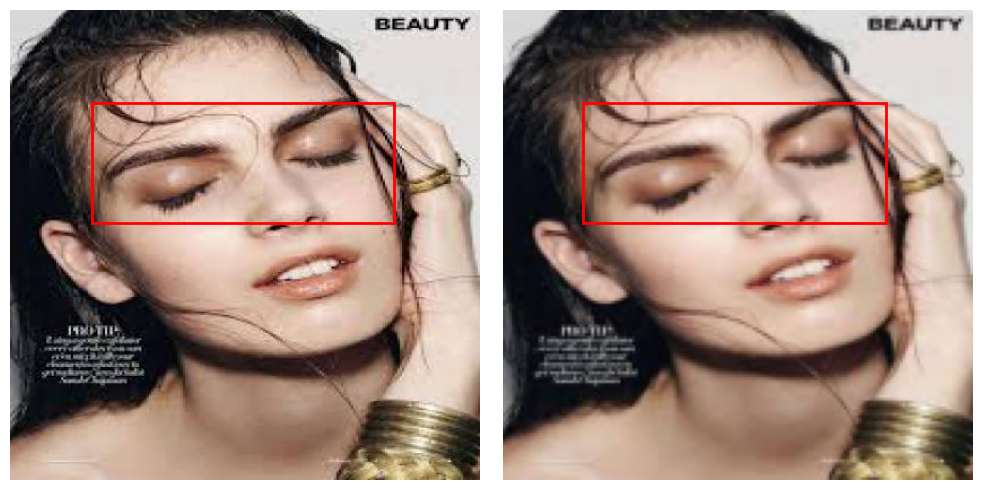

Original: 416x416
Resized: 160x160


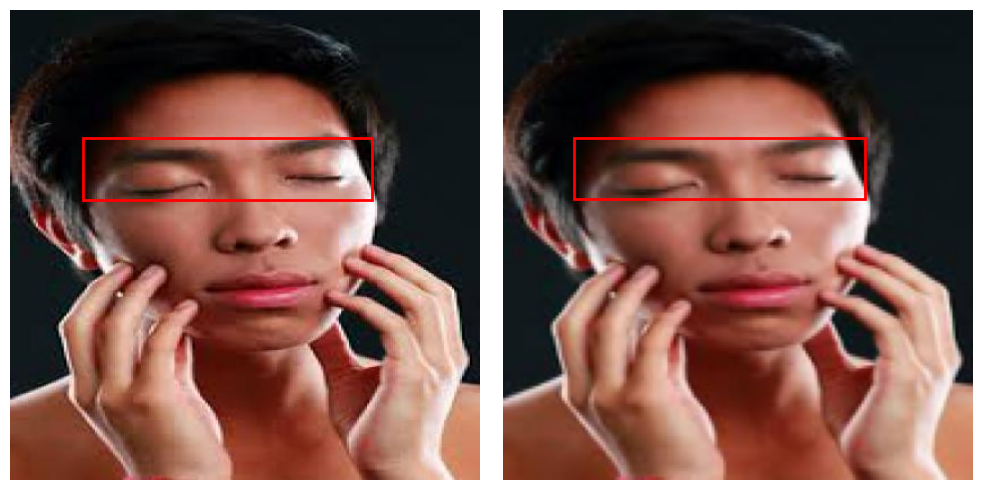

Original: 416x416
Resized: 160x160


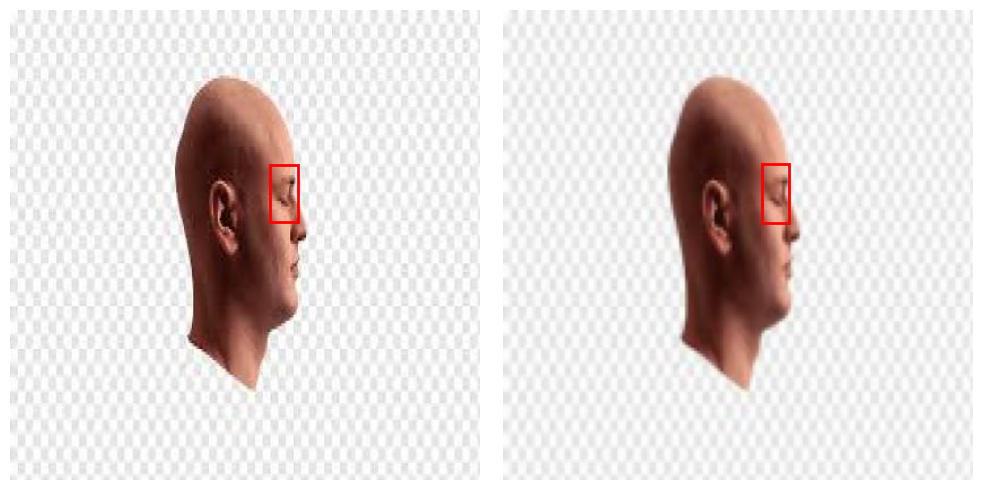

Original: 416x416
Resized: 160x160


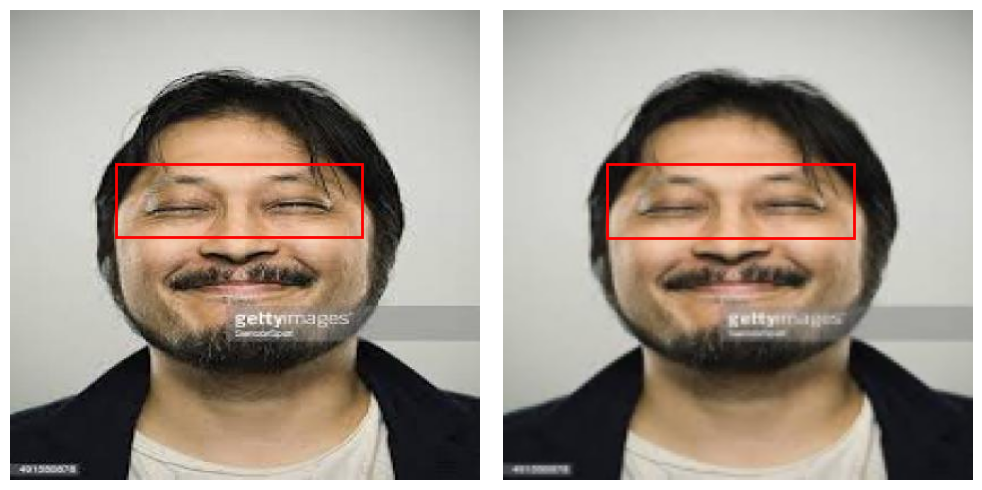

Original: 416x416
Resized: 160x160


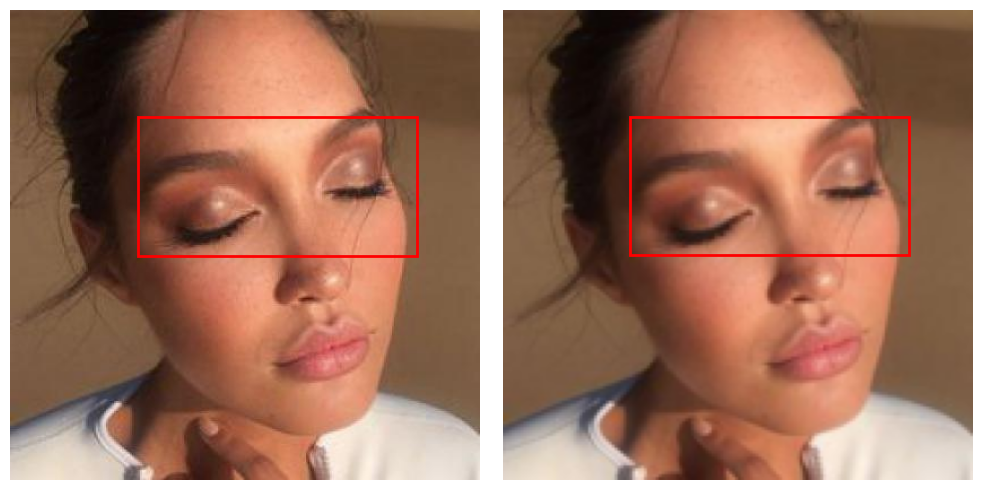

Original: 416x416
Resized: 160x160


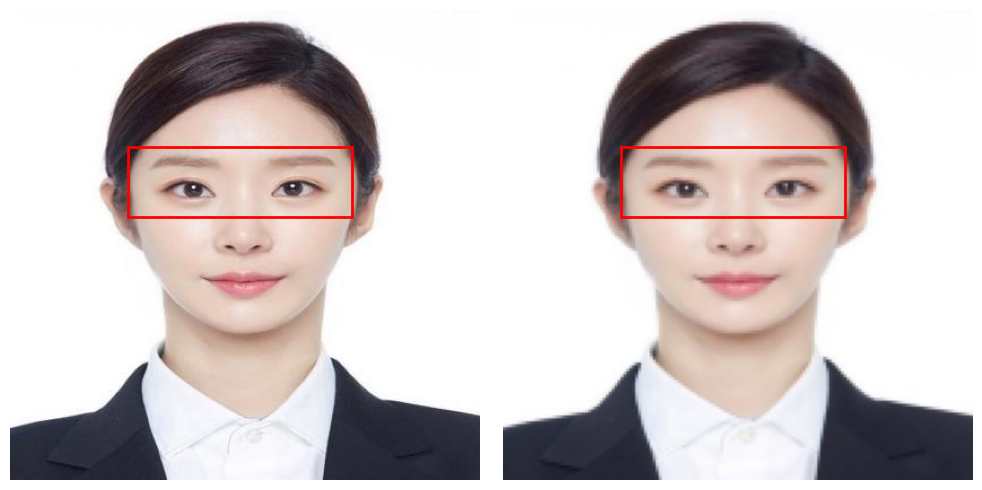

Original: 416x416
Resized: 160x160


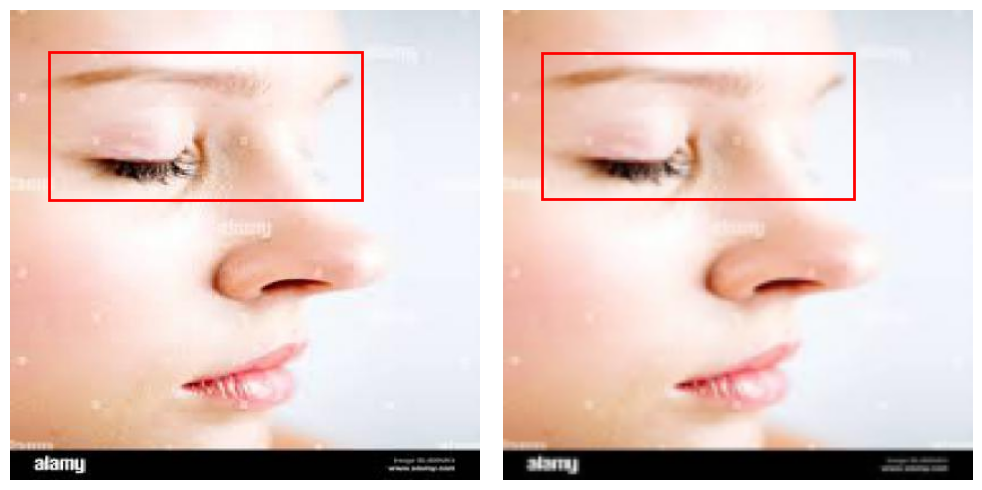

Original: 416x416
Resized: 160x160


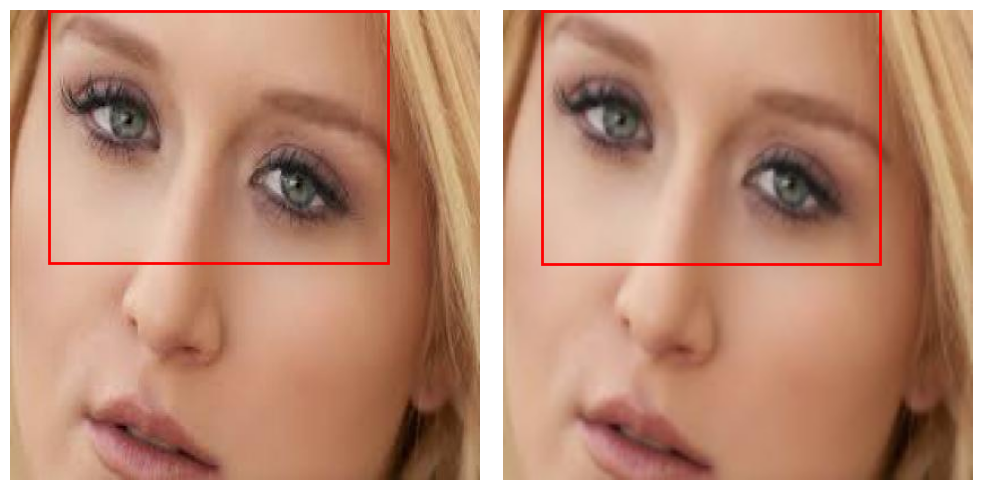

Original: 416x416
Resized: 160x160


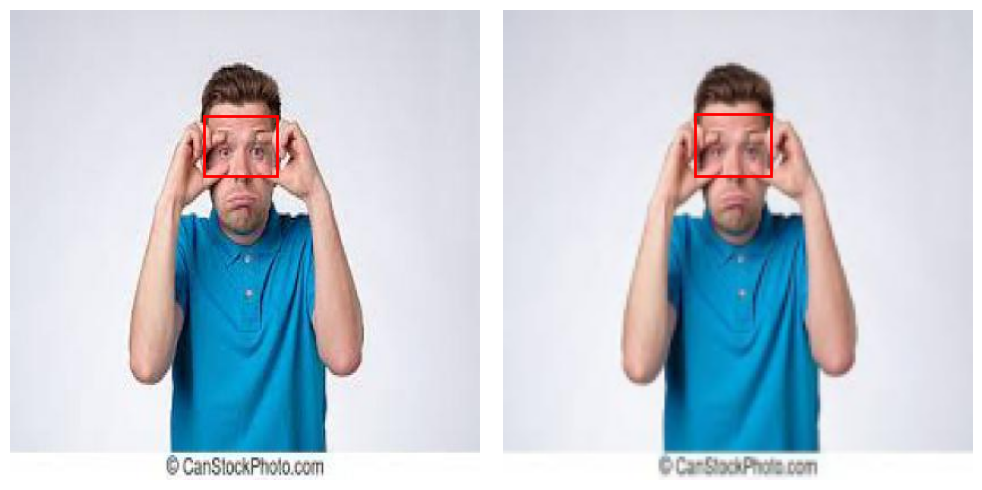

Original: 416x416
Resized: 160x160


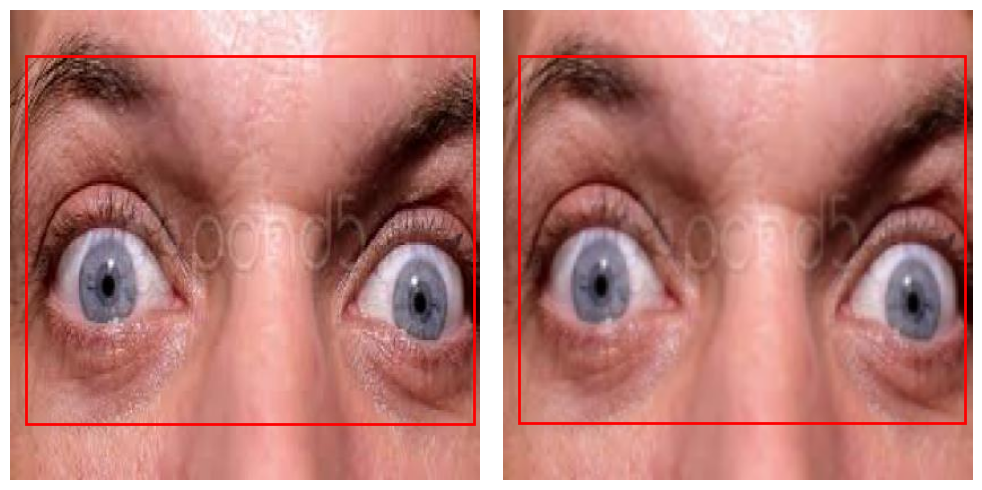

Original: 416x416
Resized: 160x160


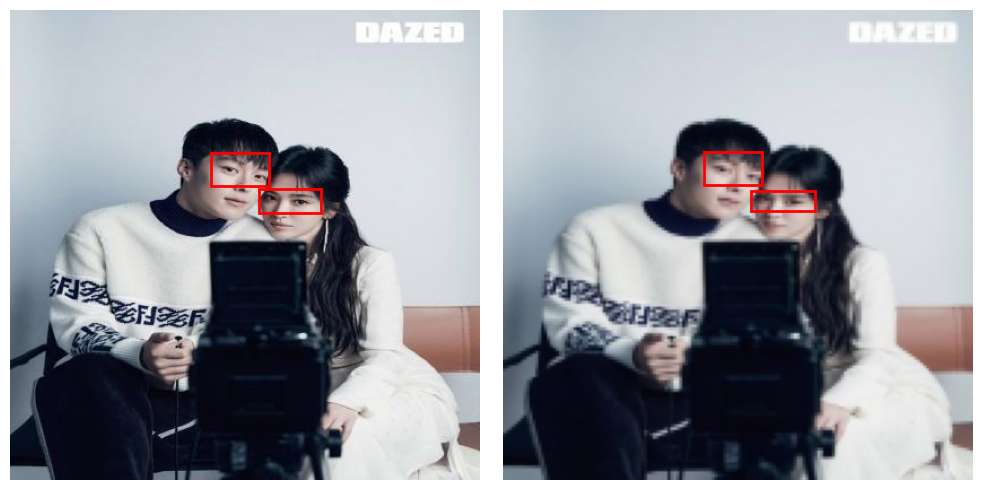

Original: 416x416
Resized: 160x160


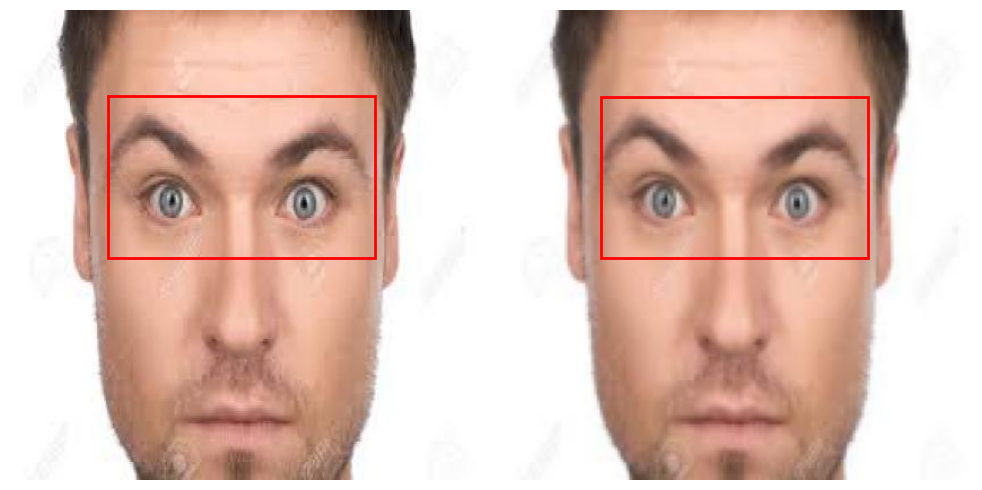

Original: 416x416
Resized: 160x160


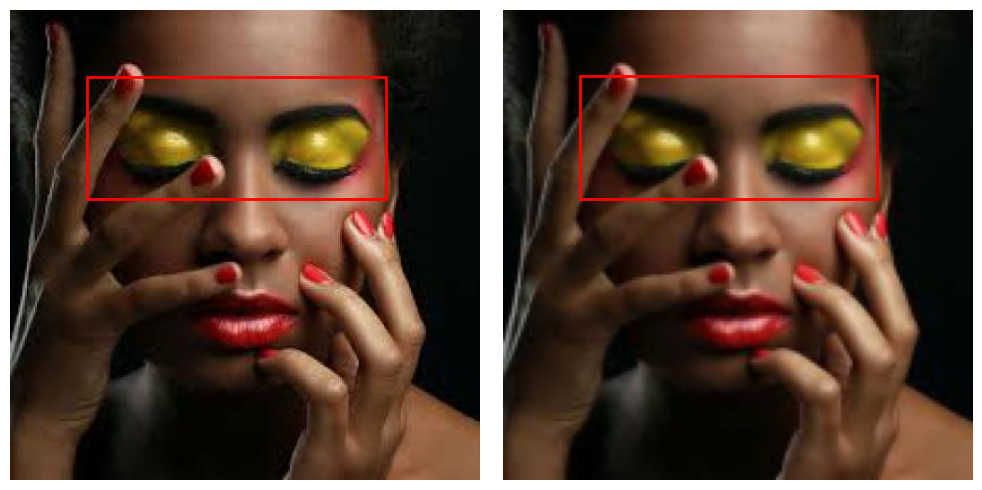

Original: 416x416
Resized: 160x160


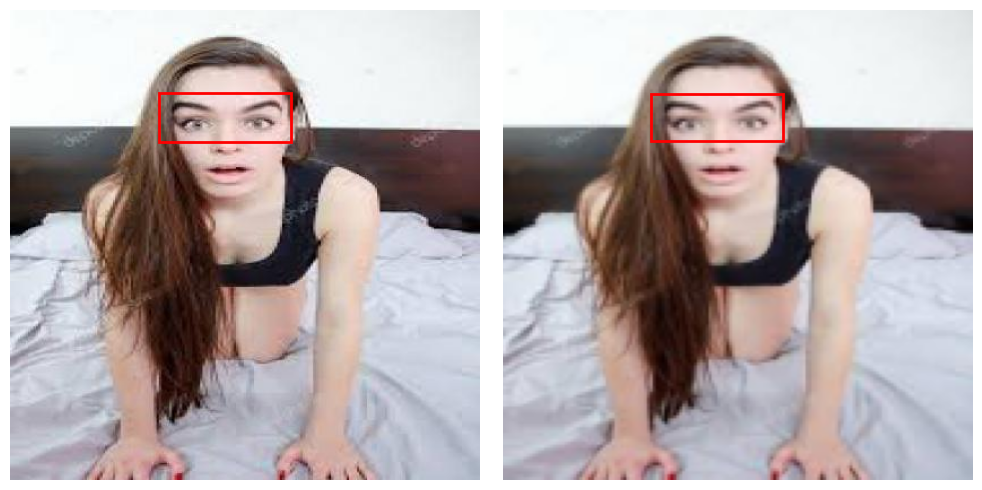

Original: 416x416
Resized: 160x160


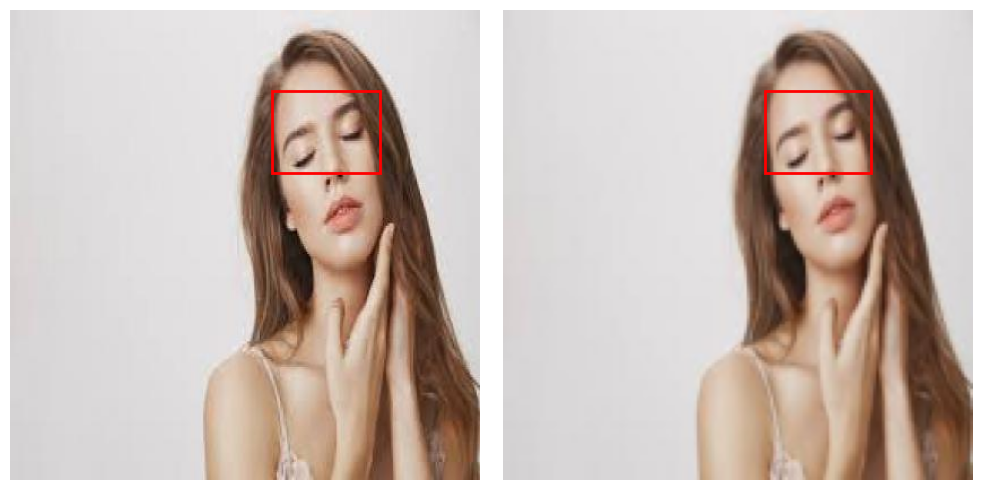

Original: 416x416
Resized: 160x160


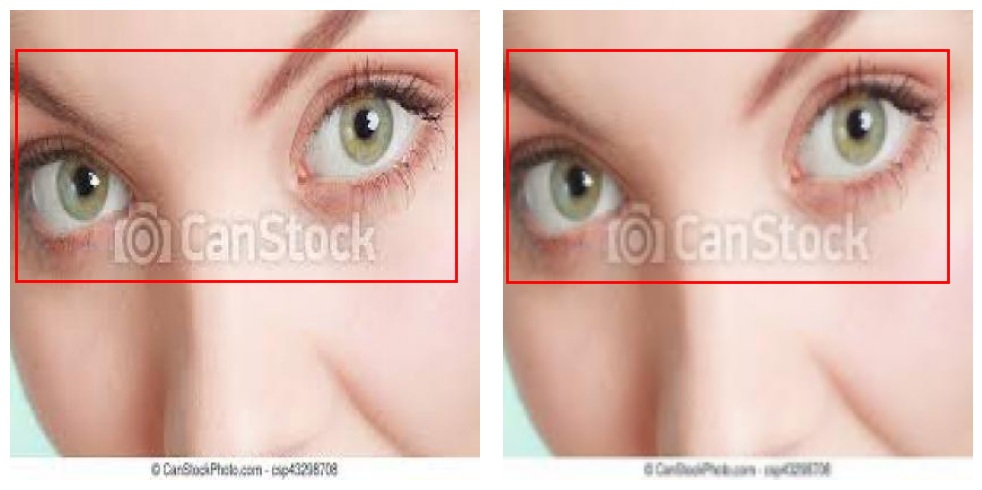

Original: 416x416
Resized: 160x160


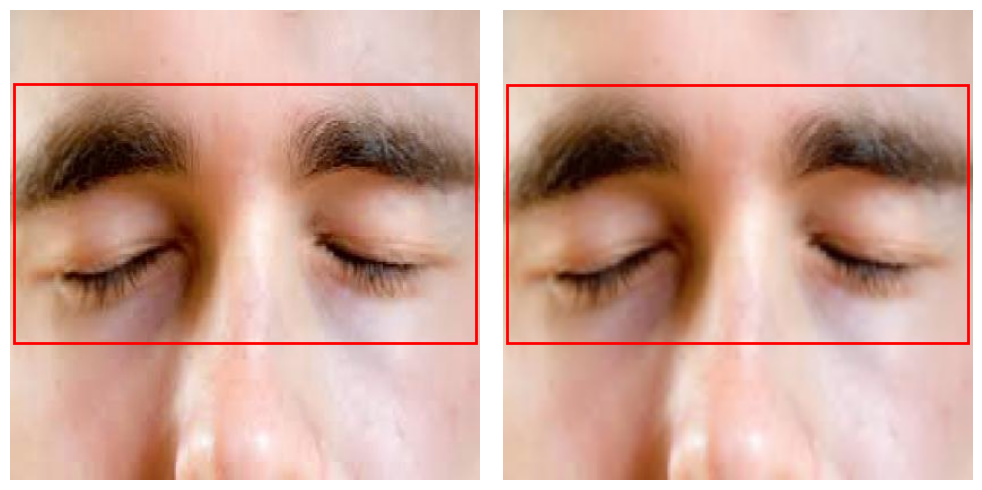

Original: 416x416
Resized: 160x160


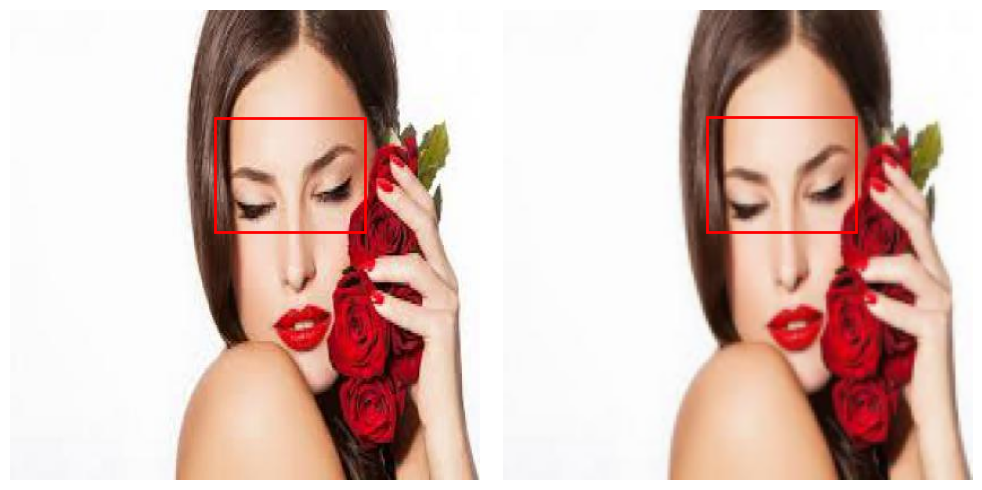

Original: 416x416
Resized: 160x160


In [ ]:
reshapeImageAndBox(train_filepaths, new_dim=160)
reshapeImageAndBox(val_filepaths, new_dim=160)
reshapeImageAndBox(test_filepaths, new_dim=160)